# Classification Report with GLCM and BERT

In [60]:
# libs
import numpy as np
import pandas as pd

import glob
import time
import random
import cv2
import os
from PIL import Image
# from tqdm import tqdm
from pickle import dump , load

import matplotlib.pyplot as plt

# import tensorflow as tf
# from tensorflow.image import resize
# from transformers import BertTokenizer, BertModel
# import torch

import keras
from keras.models import Model, load_model
from tensorflow.keras.preprocessing.image import load_img
from keras.applications.vgg19 import preprocess_input
from keras.applications import ResNet50
from keras.layers import Input, Dense, Concatenate, Flatten, Dropout, BatchNormalization
from keras.optimizers import Adam

from skimage import io, color
from skimage.feature import greycomatrix, greycoprops

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics.pairwise import cosine_similarity


from gensim.models import FastText
from gensim.utils import simple_preprocess


import tensorflow as tf
from tensorflow.keras.regularizers import l2
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
# from gensim.models.keyedvectors import KeyedVectors
# import gensim.downloader as api


import warnings
warnings.filterwarnings('ignore')

In [61]:
# import numpy
# print(numpy.__version__)

In [150]:
# Function to extract visual features using ResNet50
def extract_visual_features(image_path):
    img = Image.open(image_path)
    img = img.resize((224, 224))  # Resize image for ResNet50 input
    img_array = np.array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = tf.keras.applications.resnet50.preprocess_input(img_array)

    model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
    visual_features = model.predict(img_array)

    return visual_features

# Function to compute GLCM texture features
def compute_texture_features(image_path):
    # Define your GLCM properties (distances and angles)
    distances = [1, 3, 5, 3, 1, 3, 5]
    angles = [0, 0, 0, np.pi/4, np.pi/2, np.pi/2, np.pi/2]

    glcm_features = []
    for distance, angle in zip(distances, angles):
        img_gray = Image.open(image_path).convert('L')  # Convert image to grayscale
        img_gray_array = np.array(img_gray)

        # Compute GLCM properties
        glcm = greycomatrix(img_gray_array, distances=[distance], angles=[angle], levels=256, symmetric=True, normed=True)
        contrast = greycoprops(glcm, 'contrast')[0, 0]
        dissimilarity = greycoprops(glcm, 'dissimilarity')[0, 0]
        homogeneity = greycoprops(glcm, 'homogeneity')[0, 0]
        energy = greycoprops(glcm, 'energy')[0, 0]
        correlation = greycoprops(glcm, 'correlation')[0, 0]

#         print('contrast, dissimilarity, homogeneity, energy, correlation')
#         print(contrast, dissimilarity, homogeneity, energy, correlation)

        glcm_features.extend([contrast, dissimilarity, homogeneity, energy, correlation])

    return np.array(glcm_features) # np.array([contrast, dissimilarity, homogeneity, energy, correlation])

# Load image data and compute features
def load_data_and_compute_features(data_dir):
    visual_features = []
    texture_features = []
    labels = []

    classes = os.listdir(data_dir)
    class_to_index = {cls: idx for idx, cls in enumerate(classes)}
    # print(f"classes : {classes} \nclass_to_index : {class_to_index}")

    for cls in classes:
        cls_dir = os.path.join(data_dir, cls)

        print(f"Processing class: {cls}")  # Replacing tqdm with a simple print statement

        for img_name in os.listdir(cls_dir):
            img_path = os.path.join(cls_dir, img_name)

            # Extract visual features using ResNet50
            visual_feat = extract_visual_features(img_path)
            visual_features.append(visual_feat)
            # print(f"visual_features : {visual_features}")

            # Compute texture features using GLCM
            texture_feat = compute_texture_features(img_path)
            texture_features.append(texture_feat)
            # print(f"texture_features : {texture_features}")

            # Assign label index
            labels.append(class_to_index[cls])
            # print(f"img_path : {img_path} || labels : {class_to_index[cls]} \n")
            # print(f"texture_features : {texture_feat} \n")

    visual_features = np.array(visual_features)
    texture_features = np.array(texture_features)
    labels = np.array(labels)

    return visual_features, texture_features, labels

# Build and train a classification model
def build_and_train_model(visual_features, texture_features, labels):
    # Concatenate visual and texture features
    combined_features = np.concatenate([visual_features, texture_features], axis=1)
    # combined_features = np.concatenate([visual_features.reshape(visual_features.shape[0], -1), texture_features], axis=1)

    # Normalize the features
    min_max_scaler = StandardScaler()
    train_normalized_texture_features = min_max_scaler.fit_transform(combined_features)
    train_normalized_texture_features_df = pd.DataFrame(train_normalized_texture_features)

    # save
    dump(min_max_scaler, open('min_max_scaler_h5_CUB_reduced_dataset.pkl', 'wb'))

    # Split data into train and test sets
#     X_train, X_test, y_train, y_test = train_test_split(combined_features, labels, test_size=0.3, random_state=42, stratify=labels)
    X_train, X_test, y_train, y_test = train_test_split(train_normalized_texture_features_df, labels, test_size=0.3, random_state=42, stratify=labels)
    
    # Learning rate scheduler to reduce LR on plateau
    lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6)

#     # Define classification model - m1
#     input_layer = Input(shape=(combined_features.shape[1],))
#     # hidden_layer = Dense(128, activation='relu')(input_layer)
#     # output_layer = Dense(len(np.unique(labels)), activation='softmax')(hidden_layer)

#     # model = Model(inputs=input_layer, outputs=output_layer)
#     # model.summary()
#     hidden_layer = Dense(1024, activation='relu')(input_layer)
#     hidden_layer = Dropout(0.5)(hidden_layer)

#     hidden_layer = Dense(512, activation='relu')(hidden_layer)
#     # hidden_layer = BatchNormalization()(hidden_layer)  # Add Batch Normalization
#     hidden_layer = Dropout(0.5)(hidden_layer)

#     hidden_layer = Dense(256, activation='relu')(hidden_layer)
#     # hidden_layer = BatchNormalization()(hidden_layer)  # Add Batch Normalization
#     hidden_layer = Dropout(0.5)(hidden_layer)
    
#     # hidden_layer = Dense(128, activation='relu')(hidden_layer)
#     # # hidden_layer = BatchNormalization()(hidden_layer)  # Add Batch Normalization
#     # hidden_layer = Dropout(0.5)(hidden_layer)
    
#     # hidden_layer = Dense(64, activation='relu')(hidden_layer)
#     # hidden_layer = BatchNormalization()(hidden_layer)  # Add Batch Normalization
#     # hidden_layer = Dropout(0.3)(hidden_layer)
    
#     output_layer = Dense(len(np.unique(labels)), activation='softmax')(hidden_layer)

#     model = Model(inputs=input_layer, outputs=output_layer)

#     m2
    input_layer = Input(shape=(combined_features.shape[1],))

    # First hidden layer with L2 regularization and Batch Normalization
    hidden_layer = Dense(1024, activation='relu', kernel_regularizer=l2(0.01))(input_layer)
    hidden_layer = BatchNormalization()(hidden_layer)
    hidden_layer = Dropout(0.2)(hidden_layer)

    # Second hidden layer
    hidden_layer = Dense(512, activation='relu', kernel_regularizer=l2(0.01))(hidden_layer)
    hidden_layer = BatchNormalization()(hidden_layer)
    hidden_layer = Dropout(0.2)(hidden_layer)

    # Third hidden layer
    hidden_layer = Dense(256, activation='relu', kernel_regularizer=l2(0.01))(hidden_layer)
    hidden_layer = BatchNormalization()(hidden_layer)
    hidden_layer = Dropout(0.2)(hidden_layer)
    
    # Third hidden layer
    hidden_layer = Dense(128, activation='relu', kernel_regularizer=l2(0.01))(hidden_layer)
    hidden_layer = BatchNormalization()(hidden_layer)
    hidden_layer = Dropout(0.2)(hidden_layer)
    
    # Third hidden layer
    hidden_layer = Dense(64, activation='relu', kernel_regularizer=l2(0.01))(hidden_layer)
    hidden_layer = BatchNormalization()(hidden_layer)
    hidden_layer = Dropout(0.2)(hidden_layer)

    # Output layer
    output_layer = Dense(len(np.unique(labels)), activation='softmax')(hidden_layer)

    # Model definition
    model = Model(inputs=input_layer, outputs=output_layer)
    
    model.summary()

    print('\n\n')
    print('_'*80)
    print('\n\n')

    model.compile(optimizer=Adam(learning_rate=0.001), 
                  loss='sparse_categorical_crossentropy', 
                  metrics=['accuracy'])
    
#     model.compile(optimizer='adam',
#                   loss='sparse_categorical_crossentropy',  # Change to sparse for non-one-hot labels
#                   metrics=['accuracy'])

    # Train the model
    history = model.fit(X_train, y_train, 
                        epochs=100, 
                        batch_size=64, 
                        validation_data=(X_test, y_test), 
                        callbacks=[lr_scheduler])

    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs = range(1, len(acc)+1)

    plt.plot(epochs, acc, label='training accuracy')
    plt.plot(epochs, val_acc, label='validation accuracy')
    plt.legend()
    plt.xlabel('epochs')
    plt.ylabel('accuracy')
    plt.title('Training validation Accuracy')
    plt.show()

    plt.plot(epochs, loss, label='training loss')
    plt.plot(epochs, val_loss, label='validation loss')
    plt.legend()
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.title('Training validation Loss')
    plt.show()

    # return history # model
    return model


In [151]:
# sentences = ['Laysan_Albatross', 'Parakeet_Auklet', 'Rhinoceros_Auklet', 'Rusty_Blackbird', 'Yellow_headed_Blackbird', 'Gray_Catbird', 'Red_faced_Cormorant', 'Yellow_billed_Cuckoo', 'Vermilion_Flycatcher', 'Yellow_bellied_Flycatcher', 'Pied_billed_Grebe', 'Pine_Grosbeak', 'Rose_breasted_Grosbeak', 'Ivory_Gull', 'Western_Gull', 'Rufous_Hummingbird', 'Green_Jay', 'Gray_Kingbird', 'Pied_Kingfisher', 'White_breasted_Kingfisher', 'White_breasted_Nuthatch', 'Orchard_Oriole', 'Scott_Oriole', 'Le_Conte_Sparrow', 'Lincoln_Sparrow', 'Nelson_Sharp_tailed_Sparrow', 'Savannah_Sparrow', 'Seaside_Sparrow', 'Song_Sparrow', 'Tree_Sparrow', 'Vesper_Sparrow', 'White_crowned_Sparrow', 'White_throated_Sparrow', 'Tree_Swallow', 'Summer_Tanager', 'Elegant_Tern', 'Forsters_Tern', 'Red_eyed_Vireo', 'White_eyed_Vireo', 'Mourning_Warbler', 'Orange_crowned_Warbler', 'Palm_Warbler', 'Pine_Warbler', 'Tennessee_Warbler',
#  'Worm_eating_Warbler', 'Yellow_Warbler', 'Louisiana_Waterthrush', 'Red_headed_Woodpecker', 'Marsh_Wren', 'Rock_Wren']

# # Convert sentences into list of lists (each name as a single token)
# sentences = [[sentence] for sentence in sentences]

# # Train FastText model
# model_FastText = FastText(sentences, vector_size=300, window=5, min_count=1, epochs=10000)

# # Print model summary
# print(f"Model Vocabulary: {model_FastText.wv.index_to_key}")
# model_FastText.wv, len(model_FastText.wv), len(model_FastText.wv[0]) # model.wv.key_to_index

In [152]:
# import os
# from PIL import Image

# def find_black_and_white_images(base_dir):
#     """
#     Function to find black-and-white images in a directory containing subdirectories of image classes.
    
#     Args:
#         base_dir (str): Path to the base directory containing class subfolders.
        
#     Returns:
#         List of paths to black-and-white images.
#     """
#     bw_images = []  # List to store paths of black-and-white images

#     # Iterate through each class folder
#     for root, dirs, files in os.walk(base_dir):
#         for file in files:
#             file_path = os.path.join(root, file)
#             try:
#                 # Open image and check its mode
#                 with Image.open(file_path) as img:
#                     if img.mode != 'RGB':  # If the image mode is not RGB, it's likely black-and-white
#                         bw_images.append(file_path)
#             except Exception as e:
#                 print(f"Error processing {file_path}: {e}")
    
#     return bw_images

# # Example usage
# base_directory = r"D:\ZSL\Dataset\CUB_dataset_12_june_2024\archive\Test_class"  # Replace with your folder path
# bw_images = find_black_and_white_images(base_directory)

# if bw_images:
#     print("Black-and-white images found:")
#     for img_path in bw_images:
#         print(img_path)
#         # Uncomment the following line to delete the image
#         # os.remove(img_path)
# else:
#     print("No black-and-white images found.")


In [153]:
# # load_data_and_compute_features
# data_directory = r'D:\ZSL\Dataset\CUB_dataset_12_june_2024\archive\reduced_cub_dataset_k_mean_clustering'
# visual_features, texture_features, labels = load_data_and_compute_features(data_directory)
# print('Done')
# visual_features.shape, texture_features.shape, labels.shape

In [154]:
# visual_features.shape, texture_features.shape, labels.shape

In [155]:
# len(list(visual_features[0, 0]))

In [156]:
# data_vt = pd.DataFrame(np.concatenate([visual_features.reshape(visual_features.shape[0], -1), texture_features], axis=1))
# data_vt['labels'] = labels
# # data_vt

In [157]:
# data_vt.to_csv('visual_features_texture_features_labels_cub_dataset.csv', index=False)

In [158]:
# pd.DataFrame(data=visual_features.reshape(12106, -1))

# visual_features, texture_features, labels

# data_vt.shape
# data_vt.iloc[:,:2048]
# data_vt.iloc[:,-36:-1]
# data_vt.iloc[:,2048:-1]
# data_vt.iloc[:,-1]

# data_vt['labels']
# visual_features.shape[0]

# 2084-2048

In [159]:
# load csv
data_vtl = pd.read_csv('visual_features_texture_features_labels_cub_dataset.csv')
visual_features, texture_features, labels = data_vtl.iloc[:,:2048], data_vtl.iloc[:,2048:-1], data_vtl.iloc[:,-1]

Model: "model_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_14 (InputLayer)       [(None, 2083)]            0         
                                                                 
 dense_49 (Dense)            (None, 1024)              2134016   
                                                                 
 batch_normalization_31 (Ba  (None, 1024)              4096      
 tchNormalization)                                               
                                                                 
 dropout_37 (Dropout)        (None, 1024)              0         
                                                                 
 dense_50 (Dense)            (None, 512)               524800    
                                                                 
 batch_normalization_32 (Ba  (None, 512)               2048      
 tchNormalization)                                        

65/65 [==============================] - 4s 69ms/step - loss: 1.9802 - accuracy: 0.8464 - val_loss: 2.7714 - val_accuracy: 0.6266 - lr: 5.0000e-04
Epoch 34/100
65/65 [==============================] - 4s 68ms/step - loss: 1.9324 - accuracy: 0.8437 - val_loss: 2.9270 - val_accuracy: 0.5963 - lr: 5.0000e-04
Epoch 35/100
65/65 [==============================] - 4s 68ms/step - loss: 1.7780 - accuracy: 0.8907 - val_loss: 2.4847 - val_accuracy: 0.6687 - lr: 2.5000e-04
Epoch 36/100
65/65 [==============================] - 4s 68ms/step - loss: 1.4614 - accuracy: 0.9463 - val_loss: 2.3538 - val_accuracy: 0.6749 - lr: 2.5000e-04
Epoch 37/100
65/65 [==============================] - 4s 68ms/step - loss: 1.2599 - accuracy: 0.9644 - val_loss: 2.1792 - val_accuracy: 0.6738 - lr: 2.5000e-04
Epoch 38/100
65/65 [==============================] - 4s 68ms/step - loss: 1.1396 - accuracy: 0.9605 - val_loss: 2.1372 - val_accuracy: 0.6654 - lr: 2.5000e-04
Epoch 39/100
65/65 [==============================] -

65/65 [==============================] - 5s 73ms/step - loss: 0.2846 - accuracy: 1.0000 - val_loss: 1.4372 - val_accuracy: 0.6923 - lr: 3.1250e-05
Epoch 85/100
65/65 [==============================] - 4s 68ms/step - loss: 0.2781 - accuracy: 0.9995 - val_loss: 1.4428 - val_accuracy: 0.6929 - lr: 3.1250e-05
Epoch 86/100
65/65 [==============================] - 5s 74ms/step - loss: 0.2718 - accuracy: 0.9986 - val_loss: 1.4354 - val_accuracy: 0.6934 - lr: 3.1250e-05
Epoch 87/100
65/65 [==============================] - 5s 76ms/step - loss: 0.2672 - accuracy: 0.9974 - val_loss: 1.4555 - val_accuracy: 0.6833 - lr: 3.1250e-05
Epoch 88/100
65/65 [==============================] - 5s 81ms/step - loss: 0.2575 - accuracy: 0.9995 - val_loss: 1.4459 - val_accuracy: 0.6816 - lr: 3.1250e-05
Epoch 89/100
65/65 [==============================] - 5s 76ms/step - loss: 0.2532 - accuracy: 0.9988 - val_loss: 1.4438 - val_accuracy: 0.6867 - lr: 3.1250e-05
Epoch 90/100
65/65 [==============================] -

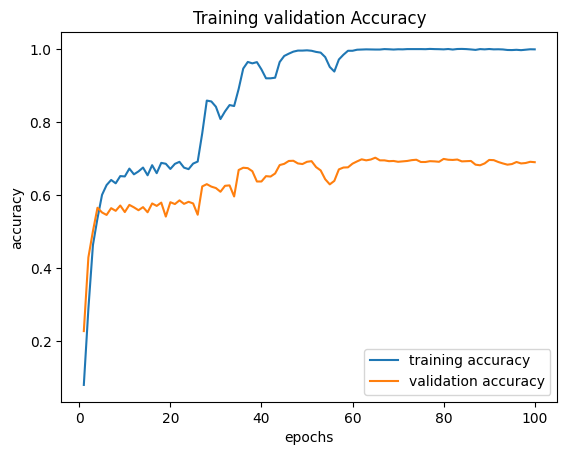

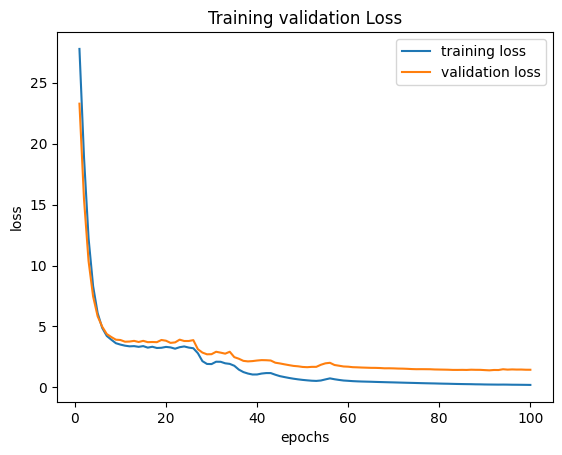

In [160]:
# Build and train the classification model
classification_model = build_and_train_model(visual_features, texture_features, labels)
classification_model

In [ ]:
# classification_model.summary()

In [21]:
# save model and architecture to single file
classification_model.save("model_h5_CUB_Hybrid_feature.h5")
print("Saved model to disk")

Saved model to disk


In [5]:
classification_model = load_model("model_h5_CUB_Hybrid_feature.h5")

In [25]:
for img_path in glob.glob(r"D:\ZSL\Dataset\CUB_dataset_12_june_2024\archive\reduced_cub_dataset_k_mean_clustering\*"):

    print(img_path.split('\\')[-1].split('.')[-1], end="', '")


Black_footed_Albatross', 'Groove_billed_Ani', 'Crested_Auklet', 'Least_Auklet', 'Brewer_Blackbird', 'Red_winged_Blackbird', 'Bobolink', 'Indigo_Bunting', 'Lazuli_Bunting', 'Cardinal', 'Spotted_Catbird', 'Yellow_breasted_Chat', 'Eastern_Towhee', 'Chuck_will_Widow', 'Brandt_Cormorant', 'Brown_Creeper', 'American_Crow', 'Fish_Crow', 'Black_billed_Cuckoo', 'Northern_Flicker', 'Acadian_Flycatcher', 'Great_Crested_Flycatcher', 'Least_Flycatcher', 'Scissor_tailed_Flycatcher', 'Frigatebird', 'Northern_Fulmar', 'Gadwall', 'Boat_tailed_Grackle', 'Eared_Grebe', 'Horned_Grebe', 'Blue_Grosbeak', 'Evening_Grosbeak', 'Pigeon_Guillemot', 'California_Gull', 'Glaucous_winged_Gull', 'Heermann_Gull', 'Herring_Gull', 'Anna_Hummingbird', 'Ruby_throated_Hummingbird', 'Green_Violetear', 'Blue_Jay', 'Florida_Jay', 'Dark_eyed_Junco', 'Tropical_Kingbird', 'Belted_Kingfisher', 'Green_Kingfisher', 'Red_legged_Kittiwake', 'Horned_Lark', 'Pacific_Loon', 'Mallard', 'Western_Meadowlark', 'Mockingbird', 'Nighthawk', 'C

# Classification Report

In [4]:
# Load models
classification_model = load_model('model_h5_CUB_Hybrid_feature.h5')
min_max_scaler_model = load(open('min_max_scaler_h5_CUB_reduced_dataset.pkl', 'rb'))
class_labels = ['Black_footed_Albatross', 'Groove_billed_Ani', 'Crested_Auklet', 'Least_Auklet',
 'Brewer_Blackbird', 'Red_winged_Blackbird', 'Bobolink', 'Indigo_Bunting', 'Lazuli_Bunting', 
 'Cardinal', 'Spotted_Catbird', 'Yellow_breasted_Chat', 'Eastern_Towhee', 'Chuck_will_Widow', 'Brandt_Cormorant',
  'Brown_Creeper', 'American_Crow', 'Fish_Crow', 'Black_billed_Cuckoo', 'Northern_Flicker', 'Acadian_Flycatcher', 
  'Great_Crested_Flycatcher', 'Least_Flycatcher', 'Scissor_tailed_Flycatcher', 'Frigatebird', 'Northern_Fulmar', 'Gadwall',
   'Boat_tailed_Grackle', 'Eared_Grebe', 'Horned_Grebe', 'Blue_Grosbeak', 'Evening_Grosbeak', 'Pigeon_Guillemot', 'California_Gull', 
   'Glaucous_winged_Gull', 'Heermann_Gull', 'Herring_Gull', 'Anna_Hummingbird', 'Ruby_throated_Hummingbird', 'Green_Violetear', 'Blue_Jay',
    'Florida_Jay', 'Dark_eyed_Junco', 'Tropical_Kingbird', 'Belted_Kingfisher', 'Green_Kingfisher', 'Red_legged_Kittiwake', 'Horned_Lark', 
    'Pacific_Loon', 'Mallard', 'Western_Meadowlark', 'Mockingbird', 'Nighthawk', 'Clark_Nutcracker', 'Baltimore_Oriole', 'Hooded_Oriole', 
    'Ovenbird', 'Brown_Pelican', 'White_Pelican', 'Western_Wood_Pewee', 'Sayornis', 'American_Pipit', 'Whip_poor_Will', 'Horned_Puffin', 'American_Redstart', 'Geococcyx', 'Baird_Sparrow', 'Black_throated_Sparrow', 'Brewer_Sparrow', 'Chipping_Sparrow', 'Clay_colored_Sparrow', 'House_Sparrow', 'Field_Sparrow', 'Fox_Sparrow', 'Grasshopper_Sparrow', 'Harris_Sparrow', 'Henslow_Sparrow', 'Cape_Glossy_Starling', 'Bank_Swallow', 'Barn_Swallow', 'Scarlet_Tanager', 'Artic_Tern', 'Black_Tern', 'Caspian_Tern', 'Green_tailed_Towhee', 'Black_capped_Vireo', 'Blue_headed_Vireo', 'Philadelphia_Vireo', 'Bay_breasted_Warbler', 'Black_throated_Blue_Warbler', 'Blue_winged_Warbler', 'Canada_Warbler', 'Cerulean_Warbler', 'Hooded_Warbler', 'Magnolia_Warbler', 'Northern_Waterthrush', 'Pileated_Woodpecker', 
'Red_bellied_Woodpecker', 'Bewick_Wren', 'Carolina_Wren', 'Common_Yellowthroat']


In [5]:


image_path, image_label, pred_label, asimilar_words = [], [], [], []
results = []
output_csv = "Hybrid_feature_classification_results_1.csv"

for img_path in glob.glob(r"D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1/*/*"):
    print(f"img_path : {img_path}")
    
    # Extract the actual label from folder name
    actual_label = img_path.split('\\')[-2].split('.')[-1]
    image_path.append(img_path)
    image_label.append(actual_label)

    # Extract visual features using ResNet50
    visual_features = extract_visual_features(img_path)

    # Compute texture features using GLCM
    texture_features = compute_texture_features(img_path)

    # Concatenate visual and texture features
    combined_features = np.concatenate((visual_features[0], texture_features))

    # Normalize the features
    train_normalized_texture_features = min_max_scaler_model.transform([combined_features])
    train_normalized_texture_features_df = pd.DataFrame(train_normalized_texture_features)

    # Predict the class
    predicted_value = classification_model.predict(train_normalized_texture_features_df)
    predicted_label_index = np.argmax(predicted_value)
    predicted_label = class_labels[predicted_label_index]
    pred_label.append(predicted_label)

    # Find similar words using FastText
    similar_words = model_FastText.wv.most_similar(predicted_label, topn=10)
    asimilar_words.append(similar_words)

    # Append results for each image
    results.append({
        "image_path": img_path,
        "image_label": actual_label,
        "Predictedlabel": predicted_label,
        "similar_words_fasttext": similar_words
    })

# Save results to a CSV file
df = pd.DataFrame(results)
df.to_csv(output_csv, index=False)
print(f"Results saved to {output_csv}")


img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0004_35808.jpg
1/1 [==============================] - 0s 49ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0005_35437.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0007_35399.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0013_35882.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0014_35424.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0015_35289.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0020_35958.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0023_35687.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0024_35949.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0029_35551.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0030_35498.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0032_35931.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0033_35379.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0035_35518.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0037_35598.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0038_35798.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0040_35981.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0041_35224.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0044_35425.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0045_35962.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0048_35670.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0049_35980.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0050_35530.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0052_35937.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0053_35262.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0055_35502.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0056_35623.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0058_35503.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0059_35507.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0062_35955.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0063_35529.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0064_35843.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0065_35713.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0067_35465.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0068_35963.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0070_35472.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0071_35386.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0072_35939.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0073_35553.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0076_35432.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0078_35410.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0081_35409.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0082_35356.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0084_35863.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0086_35483.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0091_35276.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0095_35496.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0096_35579.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0099_35872.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0100_35310.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0101_35464.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0106_35418.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0113_35703.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0114_35493.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0115_35362.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0119_35377.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0120_35764.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0122_35970.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0123_35469.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\052.Pied_billed_Grebe\Pied_Billed_Grebe_0125_35322.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0002_38214.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0003_38437.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0004_38396.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0006_38421.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0008_38486.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0009_38609.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0012_38466.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0014_38398.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0016_38743.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0018_38374.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0019_38845.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0021_38382.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0024_38403.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 596ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0025_38443.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0029_38995.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0032_38473.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0033_38945.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0034_38987.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0035_38729.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0036_38968.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0038_38956.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0039_38400.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0042_38432.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0043_38992.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0044_38766.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0046_38275.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0048_38434.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0049_38380.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0050_38475.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0052_38804.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0053_38805.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0054_38953.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0055_38730.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0056_38940.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0058_38431.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0059_38581.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0067_38524.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0068_38981.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0071_38207.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0075_38619.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0077_38929.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0078_38242.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0082_38552.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0083_38508.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0088_38830.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0091_38811.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0094_38912.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0096_38441.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0097_38735.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0100_38988.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0102_38216.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0104_38362.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0105_38210.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0106_38218.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0107_38351.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0108_38281.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0109_38451.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0111_38741.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0114_38259.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\056.Pine_Grosbeak\Pine_Grosbeak_0115_38330.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0001_39801.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0003_39223.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0004_39143.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0008_39481.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0010_39238.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0011_39207.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0012_39149.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0014_39037.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0016_39265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0017_39161.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0018_39731.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0019_39274.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0020_39152.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0024_39398.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0025_39252.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0026_39191.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0028_39271.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0029_39434.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0032_39772.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0033_39290.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0040_39689.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0042_39158.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0045_39489.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0047_39407.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0050_39695.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0051_39798.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0052_39044.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0055_39154.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0059_39045.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0060_39279.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0062_39234.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0063_39802.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0067_39592.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0068_39094.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0069_39254.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0075_39795.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0077_39613.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0080_39734.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0081_39136.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0084_39053.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0086_39658.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0087_39280.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0088_39035.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0089_39211.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0092_39367.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0095_39178.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0097_39514.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0101_39495.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0103_39580.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0104_39189.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0106_39714.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0108_39000.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0110_39373.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0114_39770.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0117_39601.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0122_39284.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0125_39597.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0126_39361.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0128_39204.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\057.Rose_breasted_Grosbeak\Rose_Breasted_Grosbeak_0135_39227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0002_49788.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0004_49019.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0005_49021.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0007_49364.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0010_49169.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0014_48983.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0015_49199.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0018_49988.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0020_49978.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0023_49385.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0024_49195.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0026_49466.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0027_48974.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0032_49322.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0035_49523.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0036_49754.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0037_49068.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0038_49298.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0039_49412.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0041_49172.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0043_49755.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0045_49696.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0050_49245.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0052_50013.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0055_49353.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0059_49662.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0061_49416.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0062_49722.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0064_49406.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0065_49566.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0067_49659.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0071_49402.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0073_49287.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0074_49698.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0077_49051.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0079_49179.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0080_49748.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0082_49306.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0085_49456_rgb.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0086_49532.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0087_49202.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0088_49177.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0089_49699.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0092_49996.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0093_49052.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0094_49347.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0096_49487.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0098_49810.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0099_49218.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0101_49790.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0104_49666.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0105_49559.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0107_49186.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0108_49356.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0109_49382.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0110_49408.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0114_49535.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0117_49227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\063.Ivory_Gull\Ivory_Gull_0118_49191.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0002_54825_rgb.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0004_55605.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 598ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0006_53504.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0007_53431.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0009_54768.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0011_53713.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0012_53605.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0013_54794.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0021_54649.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0022_54607.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0024_53631.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0025_55421.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0027_53994.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0028_55680.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0029_54143.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0030_54083.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0035_55703.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0036_54329.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0041_53554.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0042_53843.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0043_54706.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0045_54735.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0048_53776.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0049_53748.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0050_54425.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0051_54320.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0052_53485.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0057_55312.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0058_53882.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0062_53538.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0065_55728.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0066_54105.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0069_53553.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0070_54978.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0071_54207.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0073_54118.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0078_53595.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0080_53445.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0087_54193.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0089_55306.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 595ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0090_53603.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0091_55465.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0093_54925.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0094_55156.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0097_54508.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0098_53925.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0099_53670.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0100_54761.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0104_53816.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0110_53861.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0114_55644.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0115_54950.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0116_54037.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0117_44697.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0122_40866.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0124_53838.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0128_53852.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0131_53349.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0133_55639.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\066.Western_Gull\Western_Gull_0143_54909.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0002_58387.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0006_59621.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0007_58433.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0009_59405.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0011_59480.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0014_59476.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0016_59660.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0017_59520.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0018_59447.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0021_58408.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0022_58725.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0024_59636.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0025_59461.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0027_59456.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0031_58391.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0035_59434.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0036_59562.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0037_60415.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0043_58652.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0045_59533.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0046_59647.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0047_59448.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0048_58478.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0052_59581.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0055_59935.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0057_59489.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0060_58986.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0064_58509.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0065_58497.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0067_59510.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0071_59505.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0074_59231.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0075_59619.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0076_59563.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0077_59452.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0081_59592.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0089_59524.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0090_58598.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0091_60551.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0095_60360.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0100_59541.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0101_59420.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0102_59414.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0106_60465.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0109_60021.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0111_59408.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0113_59444.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0115_59202.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0116_58568.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0118_59393.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0119_59681.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0120_59900.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0121_59376.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0123_58546.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0124_58465.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0125_58932.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0127_59587.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0128_60398.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0130_59500.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\069.Rufous_Hummingbird\Rufous_Hummingbird_0134_59449.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0003_65767.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0006_65788.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0011_65947.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0014_65825.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0015_65796.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0016_65864.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0020_66168.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0023_65898.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0027_65783.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0028_65719.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0029_65637.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0030_65824.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0032_65851.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0036_65660.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0038_65702.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0039_66118.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0040_65863.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0041_65548.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0042_65740.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0043_65805.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0044_66228.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0047_65757.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0049_65600.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0051_65662.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0052_66174.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0055_65807.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0059_65586.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0063_65925.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0064_65552.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0066_65902.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0071_65799.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0074_65889.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0075_65701.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0077_65736.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0085_66077.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0086_65847.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0089_66075.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0090_65895.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0092_65884.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0094_65775.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0095_65881.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0098_65857.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0100_65786.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0102_65813.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0104_65908.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0106_65811.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0111_65869.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0114_65841.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0115_65745.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0118_66251.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0121_65564.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0124_65848.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0126_65716.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0128_65629.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0129_65680.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0130_65885.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 626ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\075.Green_Jay\Green_Jay_0132_65886.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0001_70224.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0003_70305.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0004_70293.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0005_70103.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0006_70268.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0008_70282.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0009_795023.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0010_70057.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0013_70135.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0014_70227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0016_70288.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0017_70161.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0018_70241.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0019_795013.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0021_70228.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0022_70155.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0023_795035.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0025_70152.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0026_70089.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0028_70303.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0029_795015.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0030_70110.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0031_70308.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0032_70111.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0034_70069.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0035_795027.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0036_70184.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0037_70050.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0038_70118.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0040_70313.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0041_70119.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0042_70083.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0043_795032.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0044_70322.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0045_70256.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0049_795022.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0050_70056.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0051_70139.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0052_795024.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0053_70166.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0054_70264.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0055_70290.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0056_70156.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0059_795030.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0060_795021.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0062_795026.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0063_70287.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0068_70292.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0069_70082.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0070_70051.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0071_70100.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0075_70188.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0076_70070.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0077_70191.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0080_70077.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0081_70276.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0082_795014.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0083_70162.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\078.Gray_Kingbird\Gray_Kingbird_0084_70171.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0002_71698.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0004_72135.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0007_72438.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0011_72143.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0013_72114.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0014_72119.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0015_72299.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0016_72280.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0017_72316.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0018_71657.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0019_72659.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0021_72498.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0022_72247.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0024_71560.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0025_72469.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0026_71875.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0027_71434.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0028_72221.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0029_72440.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0030_72603.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0031_71829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0032_71792.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0033_71883.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0036_72275.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0040_72739.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0045_71143.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0046_72156.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0047_72401.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0051_71429.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 603ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0053_72761.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0054_72296.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0059_72492.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0061_72193.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0062_72379.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0063_71999.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0065_71871.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0067_71641.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0068_72278.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0071_72576.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0073_72508.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0074_71830.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0075_72581.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0078_71985.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0080_72199.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0083_72430.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0085_71557.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0093_72465.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0095_72008.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0097_71895.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0102_72349.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 502us/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0106_71404.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0107_71987.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0109_72082.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0116_71900.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0117_71947.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0118_72115.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0121_72378.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0122_71789.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0128_72775.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\081.Pied_Kingfisher\Pied_Kingfisher_0132_72706.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0002_73491.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0003_73195.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0004_73741.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0011_73267.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0012_73367.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0015_73192.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0017_73355.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 593ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0018_71137.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0019_73306.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0022_73459.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0023_73230.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0024_73736.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0026_73201.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0029_73233.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0030_73335.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0032_73248.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0035_73290.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0036_73403.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0037_73220.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0040_73266.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0045_73600.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0047_73251.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0048_73292.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0049_73420.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0050_73682.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0052_73446.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0053_73476.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0054_73587.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0056_73353.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0062_73425.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0063_73365.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0065_73372.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0067_73300.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0071_73236.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0073_73498.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0074_73408.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0078_73373.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0084_73247.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0085_73363.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0087_73264.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0088_73386.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0089_73371.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0093_73311.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0096_73552.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0098_73227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 595ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0101_73261.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0103_73316.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0104_73398.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0107_73265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0109_73683.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0111_73369.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0115_73252.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0116_73295.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0117_73283.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0118_73511.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0119_73401.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0120_73439.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0121_73258.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0122_73199.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\083.White_breasted_Kingfisher\White_Breasted_Kingfisher_0123_73211.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0002_86287.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0003_86029.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0004_86969.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0010_85783.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0014_86023.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0018_85937.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0020_86143.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0024_86200.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0025_85803.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0027_85905.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0030_85823.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0036_86596.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0039_86166.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0040_86127.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0042_86488.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0043_86196.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0047_85819.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0048_86207.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0049_86557.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0050_85815.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0054_86551.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0055_86075.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0059_85903.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0060_86031.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0063_86573.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0064_86324.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0065_85829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0066_86159.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0068_86033.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0070_85983.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0075_86289.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 1s 600ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0076_85801.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0077_86462.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0078_85828.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0082_86435.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0086_86553.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0090_86856.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0092_86016.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0094_86156.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0095_86425.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0096_86140.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0097_85940.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0101_86708.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0103_86470.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0104_85969.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0106_85955.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0108_86308.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0110_86038.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0111_86621.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0113_86057.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0114_86554.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0115_86760.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0119_86182.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0120_85890.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0128_86947.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0129_86761.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0131_86416.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0132_86876.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0137_86910.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\094.White_breasted_Nuthatch\White_Breasted_Nuthatch_0142_86805.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0004_91275.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0005_91682.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0006_91724.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0009_91902.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0011_91592.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0013_91945.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0015_91565.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0017_91801.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0018_91601.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0019_91338.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0021_91644.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0023_91705.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0024_91755.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0026_91444.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0027_91265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0030_91612.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0032_91201.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0033_91532.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0034_91825.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0035_92003.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0036_91818.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0039_91267.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0041_91258.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0042_91678.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0044_91360.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0045_91205.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0046_91646.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0048_91393.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0051_91787.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0054_91414.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0055_91515.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0058_91819.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0059_92046.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0060_91536.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0061_91941.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0065_91397.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0070_91383.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0074_91979.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0075_91847.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0076_91527.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0077_91651.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0080_91417.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0082_91654.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0084_91658.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0085_91411.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0088_92086.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0091_91774.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0092_92128.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0093_92020.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0095_91345.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0098_91401.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0101_91233.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0105_91186.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0106_91830.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0107_91472.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0108_91530.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0113_88407.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0114_91412.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\097.Orchard_Oriole\Orchard_Oriole_0116_91645.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0001_795826.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0002_795829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0003_92247.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0005_92362.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0007_92439.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0008_795814.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0010_795852.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0011_795836.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0012_795837.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0014_795827.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0015_795862.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0016_92398.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0017_795832.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0018_795840.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0019_795815.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0022_92356.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0023_795835.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0024_92302.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0025_92207.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0028_92270.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0029_795846.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0030_795830.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0031_90270.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0032_795810.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0034_795813.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0035_795851.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0036_795850.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0038_795818.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0040_795839.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0042_795844.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0043_795828.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0044_92262.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0045_92237.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0046_92371.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0051_795807.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0052_92440.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0053_795805.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0054_92310.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0055_795825.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0056_795816.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0057_795856.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 934us/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0058_795849.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0063_795812.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0064_92321.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0065_795819.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0067_795858.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0068_795804.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0069_92271.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0070_795808.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0071_795848.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0072_795822.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0073_92369.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0075_795817.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0077_795831.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0078_795833.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0079_92248.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0081_92374.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0083_795821.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0084_795860.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\098.Scott_Oriole\Scott_Oriole_0085_92206.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0003_795175.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0005_795137.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0006_795146.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0007_795148.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0010_795166.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0011_117038.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0012_795211.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0013_795176.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0015_795152.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0016_795223.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0020_117035.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0021_117105.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0022_117039.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0023_795156.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0024_795190.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0025_795188.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0032_795186.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0034_795150.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0035_795214.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0039_117054.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0040_117088.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0041_795218.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0043_795213.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0044_117116.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0045_795162.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0046_795227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0047_795192.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0049_795220.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0050_795143.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0053_795187.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0055_117036.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0056_795178.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0058_795181.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0060_795160.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0061_795194.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0063_795149.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0064_795235.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0066_795206.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0067_117146.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0068_795180.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0070_795135.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0071_795185.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0072_795230.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0073_117127.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0075_795234.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0078_117052.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0081_795215.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0083_795163.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0084_795189.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0085_795167.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0086_795170.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0087_795198.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0088_117040.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0089_795154.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0092_795221.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0097_795183.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0098_795231.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0099_795182.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\124.Le_Conte_Sparrow\Le_Conte_Sparrow_0102_795195.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0009_117535.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0010_117263.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0013_117202.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0014_117883.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0017_117432.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0020_117542.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0022_117759.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0026_117754.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0032_117747.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0033_117303.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0035_117383.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0036_117280.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0037_117837.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0038_117461.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0040_117721.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0041_117636.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0042_117507.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0044_117687.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0045_117547.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0046_117405.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0047_117442.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0049_117265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0050_117744.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0052_117521.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0055_117506.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0057_117334.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0058_117503.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0059_117271.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0061_117529.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0063_117509.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0064_117602.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0066_117875.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0069_117812.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0070_117342.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0072_117951.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0074_117584.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0078_117483.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0079_117919.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0083_117272.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0084_117492.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0087_117444.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0088_117634.jpg
1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0089_117527.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0090_117857.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0092_117294.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0094_117762.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0099_117482.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0100_117835.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0108_117773.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0109_117940.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0110_117264.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0112_117631.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0113_117603.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0115_117216.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0116_117372.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0119_117270.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0128_117851.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0129_117898.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\125.Lincoln_Sparrow\Lincoln_Sparrow_0131_117277.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0001_796931.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0002_796908.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0003_796917.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0004_796941.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0005_118078.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0006_796909.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0008_796944.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0009_796940.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0013_796942.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0014_796906.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0015_796922.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0016_118077.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0017_796910.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0018_118011.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0019_118066.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0022_796905.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0023_796899.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0024_118010.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0025_796945.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0027_118028.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0029_796923.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0030_118064.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0032_118036.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0033_118024.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0034_796950.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0035_796924.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0036_118075.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0037_117986.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0038_796920.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0039_118074.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0041_796926.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0042_796911.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0044_796932.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0045_118004.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0046_118032.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0047_117991.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0049_118033.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0051_796902.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0052_796903.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0053_118069.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0054_796936.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0055_796937.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0056_117974.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0057_796949.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0058_118023.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0061_796907.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0062_796919.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0064_117965.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0065_796933.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0066_118088.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0067_796912.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0068_796930.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0070_796925.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0071_796946.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0072_118012.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0074_796901.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0076_117964.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0077_796913.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\126.Nelson_Sharp_tailed_Sparrow\Nelson_Sharp_Tailed_Sparrow_0079_796934.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0001_118956.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0005_119735.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0008_118929.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0009_120205.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0011_119459.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0014_120072.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0015_118910.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0017_119171.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0019_118200.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0021_118886.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0022_118989.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0023_120326.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0025_119124.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0028_119982.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0029_119621.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0032_120109.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0033_118871.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0035_120099.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0043_119362.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0045_119398.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0047_119365.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0048_120321.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0049_119596.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0051_118574.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0052_118583.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0054_120057.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0057_120016.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0058_118323.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0059_119810.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0061_119783.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0062_120185.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0064_119316.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0066_119949.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0067_118491.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0068_119972.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0075_116305.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0076_120267.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0079_118817.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0080_118120.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0084_120063.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0091_120630.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0093_118267.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0094_119040.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0095_119670.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0096_120376.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0106_118294.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0107_119671.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0109_119674.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0114_119750.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0115_118882.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0116_118108.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0117_119917.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0118_118603.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0124_118820.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0131_119946.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0132_119962.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0135_119620.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0136_119581.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0137_119757.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\127.Savannah_Sparrow\Savannah_Sparrow_0139_119444.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0001_120720.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0002_796536.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0003_796539.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0004_796514.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0005_796516.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0007_120690.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0008_796538.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0011_120820.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0012_120732.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0013_796535.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0015_796500.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0017_796513.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0018_120716.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0019_120826.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0020_120743.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0021_120699.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0022_120721.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0023_796525.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0024_120751.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0025_796518.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0026_120798.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0027_796512.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0028_120766.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0029_120828.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0030_120780.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0031_796526.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0032_120767.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0033_796506.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0034_796521.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0035_796533.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0036_120785.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0037_796531.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0038_120819.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0039_796530.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0041_796529.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0042_796528.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0043_796510.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0044_119287.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0045_120696.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0046_120768.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0047_796520.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0048_120758.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0049_120735.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0050_796508.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0051_796522.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0052_796498.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0054_796507.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0056_120710.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0058_120744.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0059_120794.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0062_796503.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0063_120707.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0064_120813.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0065_796504.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 31ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0066_120791.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0067_796532.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0068_796515.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0069_120700.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0070_796540.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\128.Seaside_Sparrow\Seaside_Sparrow_0071_796519.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0001_122169.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0003_122425.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0007_121133.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0009_121025.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0010_121331.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0013_121056.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0015_122081.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0020_121490.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0029_120989.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0034_121255.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0035_120986.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0036_121679.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0037_121078.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0038_121666.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0040_121617.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0042_121314.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0044_121931.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0045_121951.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0046_121903.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0050_121514.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0053_121554.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0055_121158.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0057_121090.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0058_121832.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0059_120885.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0060_122371.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0061_120891.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0067_122424.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0069_122065.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0071_122446.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0077_121196.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0080_121033.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0086_121999.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0087_121062.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0088_121615.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0089_120894.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0090_121057.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0091_121651.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0092_121969.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0096_121313.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0097_121438.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0099_121193.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0101_120920.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0102_122090.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0106_121154.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0107_120990.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 1ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0108_121327.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0110_120872.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0112_121027.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0113_121683.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0114_121233.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0116_121211.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0118_121905.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0121_121203.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0123_121249.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0125_122435.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0126_120901.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0130_121583.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0132_121153.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\129.Song_Sparrow\Song_Sparrow_0135_121261.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0005_122949.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0007_122911.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0009_123294.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0011_122964.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0015_125105.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0018_123574.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0022_123496.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0023_124956.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0024_123805.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0025_124233.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0028_122829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0030_122850.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0032_123489.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0034_123799.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0035_123211.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0036_122772.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0039_124140.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0041_123497.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0042_124512.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0043_124034.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0044_122946.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0046_125344.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0052_123869.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0053_122933.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0057_123665.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0058_123591.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0060_123743.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0062_123000.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0066_123569.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0068_125230.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0072_123991.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0073_123871.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0074_124408.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0076_123669.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0077_123417.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0080_124120.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0081_124348.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0086_123751.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0088_125305.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0090_110145.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0094_124974.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0095_124090.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0097_123462.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0100_122945.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0101_124104.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0105_123227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0107_123822.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0108_124754.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0109_123802.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0112_125014.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0113_123613.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0119_124114.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0121_124296.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0122_123927.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0123_125324.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0125_123078.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0127_125322.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0128_123979.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0129_124960.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\130.Tree_Sparrow\Tree_Sparrow_0130_124932.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0002_125454.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0003_125427.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0004_125787.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0005_125440.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0007_125630.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0009_125713.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0011_125608.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0013_109937.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0015_125653.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0016_125615.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0017_125534.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0018_125651.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0019_125558.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0020_125794.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0022_125719.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0023_125465.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0028_118217.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0029_125498.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0030_125663.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0031_125631.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0032_125564.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0033_125568.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0037_125648.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0040_125441.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0041_125458.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0043_125703.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0044_125470.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0045_125643.jpg
1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0046_125575.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0047_125788.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0049_125806.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0051_125587.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0052_125444.jpg
1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0053_125641.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0055_125611.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0056_125657.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0057_125649.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0058_125661.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0062_125669.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0065_125446.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0066_125619.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0067_125429.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0068_125601.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0070_125555.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0073_125605.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0076_125737.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0077_125597.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0079_125579.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0080_125606.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0081_125541.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0082_125503.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0083_125718.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0084_125532.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0086_125776.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0087_125712.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0089_125705.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0090_125690.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0091_125598.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0094_125602.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\131.Vesper_Sparrow\Vesper_Sparrow_0095_125459.jpg
1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0001_127115.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0002_127774.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0009_127658.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0010_127651.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0012_127853.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0017_125829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0019_127652.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0021_127092.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0029_127503.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0031_126457.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0033_127728.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0034_126199.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0037_126969.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0040_127313.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0042_128395.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0043_127096.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0044_127386.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0047_127575.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0049_128311.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0054_126068.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0057_127927.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0061_126315.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0064_126467.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0067_127576.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0068_126156.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0071_127922.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0072_127080.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0076_127604.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0078_127603.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0083_128777.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0085_127194.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0087_128008.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0089_127778.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0090_125864.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0092_125934.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0093_126531.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0094_128627.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0095_127118.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0098_127019.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0099_127213.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0100_126267.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0101_127058.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0102_127708.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0105_126818.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0107_128662.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0109_128529.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0111_127404.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0113_128095.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0114_127027.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0115_126027.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0116_127512.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0118_127919.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0119_126932.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0122_128577.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0124_128082.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0127_126923.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0129_127860.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0140_125967.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0141_127766.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\132.White_crowned_Sparrow\White_Crowned_Sparrow_0142_128237.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0002_129057.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0004_128944.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0007_128918.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0014_129148.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 31ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0015_129138.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0016_129158.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0017_128982.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0020_129007.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0021_128804.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0023_129179.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0026_128843.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0027_128847.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0028_129118.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0030_129076.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0031_128808.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0032_128866.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0033_129016.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0034_129054.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0038_128853.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0039_128859.jpg
1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0042_128899.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0043_128818.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0047_129014.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0050_129051.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0052_128923.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0056_128906.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0059_128964.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0060_128802.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0061_128902.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0063_128803.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0069_128951.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0071_128915.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0072_129203.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0073_129110.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0075_128990.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0076_129088.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0078_129041.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0082_129048.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0085_129180.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0097_128967.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0098_129089.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0102_128911.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0105_128814.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0106_128815.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0107_129046.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0108_129184.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0109_129066.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0110_128838.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0112_129101.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0113_128936.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0118_129084.jpg
1/1 [==============================] - 0s 29ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0119_128827.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0121_129201.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0123_129009.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0124_128801.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0125_128832.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0128_128956.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0132_128833.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0134_129190.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\133.White_throated_Sparrow\White_Throated_Sparrow_0135_128819.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0002_136792.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0004_135411.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0008_135352.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0013_135923.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0015_134790.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0016_135549.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0017_135062.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0019_137073.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0020_136587.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0023_135345.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0029_134882.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0030_134942.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0032_136216.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0035_136589.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0037_134647.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0039_135038.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0040_135172.jpg
1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0041_136439.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0042_136401.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0043_136878.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0044_135984.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0046_135770.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0049_134740.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0050_135104.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0056_135079.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0058_134987.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0060_134961.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0061_134712.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0062_137426.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0064_136322.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0066_135788.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0067_136244.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0069_135148.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0071_136749.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0073_134997.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0074_135219.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0075_136081.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0076_137232.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0082_135006.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0083_136800.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0087_137354.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0090_135325.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0091_136870.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0092_136236.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0095_135829.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0098_134916.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0100_137493.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0102_135061.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0103_137272.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0105_134648.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0107_136223.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 0s/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0108_135068.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0109_135272.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0110_136921.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0111_135253.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0113_136849.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0114_136265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 31ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0115_135832.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0117_134925.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\138.Tree_Swallow\Tree_Swallow_0127_135912.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0001_139289.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0004_139916.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0006_140137.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0010_139948.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0013_140828.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0017_140173.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0018_139290.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0023_139859.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0025_139320.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0030_139210.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0032_140425.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0033_140268.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0034_139781.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0035_139561.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0037_140330.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0038_139371.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0041_139902.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0043_139884.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0044_140611.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0046_139802.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0047_140164.jpg
1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0050_139358.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0052_139804.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0056_139211.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0058_139427.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0059_140582.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0062_140633.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0063_139743.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0064_140725.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0065_139198.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0066_140621.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0068_139875.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0069_139941.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0070_137714.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0071_140289.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0073_139379.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0074_139592.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0075_139858.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0080_140110.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0088_139473.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0091_139602.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0093_139517.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0094_139351.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0095_139882.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0097_140042.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0099_139310.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0101_139441.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0103_139267.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0106_139801.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0107_139488.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0109_139522.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0111_139605.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0115_139253.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0116_139923.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0117_140812.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0119_140617.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0120_140060.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0124_139963.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0125_139399.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\140.Summer_Tanager\Summer_Tanager_0127_139297.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0004_150948.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0005_150708.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0006_150963.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0008_145044.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0009_150954.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0014_150523.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0023_150654.jpg
1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0024_150852.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0026_150869.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0028_151019.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0029_150494.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0030_151067.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0032_150488.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0033_150687.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0034_45914.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0035_150744.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0036_150972.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0039_150944.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0042_150851.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0044_150946.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0045_150752.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0046_150905.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0047_150626.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0048_150693.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0050_150521.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0052_150695.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0053_150507.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0058_150853.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0060_150837.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0061_150524.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0063_150873.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0064_150822.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0065_151021.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0066_150864.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0067_151185.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0068_150526.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0070_147548.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0072_150911.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 1ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0073_150925.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0074_151036.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0076_150519.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0077_150548.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0078_151196.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0079_150953.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0080_150538.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0082_150517.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0083_150829.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0084_150922.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0085_151091.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0088_151089.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0089_150854.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0090_45924.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0093_150534.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0096_151068.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0098_151028.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0099_150682.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0101_150715.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0103_150493.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0106_150872.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\145.Elegant_Tern\Elegant_Tern_0107_150960.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0001_152174.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0002_151622.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0003_151547.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0004_152358.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0007_152110.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0010_151243.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0012_151558.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0016_152463.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0017_152696.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0021_144734.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0027_151456.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0029_151228.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0032_151384.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0034_152667.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0035_151757.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0041_149586.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0042_151644.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0043_151332.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0045_151227.jpg
1/1 [==============================] - 0s 1ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0049_151631.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0053_152175.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 1ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0057_151570.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0059_151269.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0060_152190.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0062_151780.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0064_152047.jpg
1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0065_152206.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0066_151478.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0068_152078.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0069_151229.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0070_152107.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0071_152142.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0075_152258.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0076_151330.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0077_152255.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0080_152521.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0082_151937.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0083_151282.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0086_152738.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0087_151226.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0088_151893.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0089_152372.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0091_151895.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0092_152119.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0095_152067.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0097_151731.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0098_151258.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0099_152529.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0100_151774.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0104_152666.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0109_152094.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0114_152768.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0116_151688.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0118_151564.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0119_152709.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0121_151385.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0123_151789.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0125_151399.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0126_151257.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\146.Forsters_Tern\Forsters_Tern_0127_150418.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0002_156470.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0003_157226.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0004_157224.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0006_157025.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0014_157062.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0016_156971.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0019_156921.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0020_156875.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0023_156800.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0025_157173.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0026_156751.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0029_156777.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0030_156987.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0032_156897.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0034_157219.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0036_156727.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0038_156963.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0041_156954.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0043_157162.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0044_156708.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0045_157252.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0046_157265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0049_156785.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0052_157185.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0053_156885.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0054_157158.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0055_157096.jpg
1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0056_156968.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0058_156965.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0059_156974.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0061_157202.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0062_157324.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0065_157019.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0071_156967.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0073_156944.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0074_157170.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0075_158151.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0077_157005.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0079_158198.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0083_157063.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0084_156943.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0086_157038.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0095_157082.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0096_157013.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0101_156988.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0106_157102.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0109_157176.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0111_157030.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0112_156742.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0115_157004.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0123_156780.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0126_157179.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0129_156781.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0131_156765.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0132_156686.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0133_156668.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0134_156919.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0138_156798.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0140_157237.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\154.Red_eyed_Vireo\Red_Eyed_Vireo_0141_157205.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0001_159237.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0002_159180.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0009_158830.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0012_159495.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0015_159081.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0016_158978.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0018_159450.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0019_159095.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0022_159037.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0024_159193.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0026_158963.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0029_159334.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0030_159265.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0032_159145.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0033_159079.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0040_159101.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0041_159032.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0042_159012.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0045_159232.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0046_158849.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0049_158835.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0050_158829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0051_159033.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0059_159225.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0061_159042.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0064_159286.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0066_159477.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0071_159072.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0074_159279.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0078_159382.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0080_159087.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0082_159186.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0083_159203.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0085_159119.jpg
1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0086_159202.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0088_159084.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0090_158958.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0091_159045.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0094_158894.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0095_158886.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0099_158933.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0102_159420.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0110_158947.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0111_158864.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0112_159147.jpg
1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0114_159206.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0115_158932.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0116_159028.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0118_159036.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0120_158991.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0122_159284.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0125_159078.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0126_159341.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0128_158993.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0129_158823.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0130_159075.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0132_158908.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0134_158889.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0135_158955.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\156.White_eyed_Vireo\White_Eyed_Vireo_0136_156418.jpg
1/1 [==============================] - 0s 2ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0002_166520.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0005_795372.jpg
1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0006_166595.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0007_166500.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0008_166467.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0009_166429.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0011_795380.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0012_166515.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0014_166427.jpg
1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0015_166535.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0018_795386.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0019_795347.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0020_166440.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0021_166560.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0023_795362.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0024_795363.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0025_166608.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0026_166538.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0029_166530.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0031_166494.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0033_166489.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0034_795384.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0035_166586.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0036_166432.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0037_795381.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0038_166549.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0039_166546.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0040_795370.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0041_795358.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0042_166493.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0045_166575.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0047_795373.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0048_166596.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0049_166469.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0050_795343.jpg
1/1 [==============================] - 0s 27ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0051_795352.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0052_166537.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0053_795345.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0054_795387.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0055_166436.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0056_166476.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0057_795342.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0059_795365.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0060_795355.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0061_166598.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0062_166531.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 31ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0064_166447.jpg
1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0065_795374.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0066_166491.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0067_795353.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0069_166559.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0072_795379.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0073_166524.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0074_795367.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0077_166567.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0078_795377.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0079_166564.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0081_166434.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0082_166574.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\170.Mourning_Warbler\Mourning_Warbler_0083_795376.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0001_167660.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0005_168314.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0006_167998.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0007_167545.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0009_168228.jpg
1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0011_167615.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0015_168196.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0016_168082.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0018_168126.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0019_167626.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0021_168263.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0027_168381.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0028_167641.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0030_168376.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0032_167589.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0033_167991.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0034_168185.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0037_167687.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0038_168384.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0040_168029.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0042_167614.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0048_167610.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0049_167974.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0050_168166.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0051_168002.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0052_168013.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0055_168600.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0056_167876.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0057_168424.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0059_168259.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0062_168119.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0064_166929.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0065_167952.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0066_167949.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0067_167588.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0068_167585.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0071_167595.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0078_167964.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0079_168372.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0080_167960.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0081_167647.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0083_167948.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0087_168439.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0088_168052.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0090_167607.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0091_167578.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0094_167584.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0097_168004.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0102_168189.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0103_168566.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0111_168040.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0112_168437.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0113_167984.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0114_167732.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0117_167987.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0118_167640.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0119_167658.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0120_167587.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0126_168445.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\173.Orange_crowned_Warbler\Orange_Crowned_Warbler_0128_168012.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0001_170297.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0002_169527.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0003_170474.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0004_168786.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0005_169918.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0006_169429.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0007_169473.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0010_169452.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0012_170857.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0013_169411.jpg
1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0015_169626.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0020_168857.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0024_170501.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0028_169670.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0034_170352.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0039_170894.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0040_169922.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0044_169319.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0046_169837.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0047_169354.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0049_169885.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0050_170042.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0051_169487.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0054_169175.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0055_170219.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0056_168740.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0060_168686.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0061_169954.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0066_169284.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0067_169318.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0068_170243.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0073_169781.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0075_168751.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0077_169042.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0081_169256.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0082_168709.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0083_170281.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0086_169676.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 2ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0089_168968.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0092_170604.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0093_170499.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0095_170610.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0096_170867.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0100_168725.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0102_168829.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0105_170429.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0106_169571.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0107_170620.jpg
1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0108_169426.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0110_169490.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0111_169663.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0112_169595.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0113_170080.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0116_170319.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0117_170073.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 30ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0118_170081.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0126_170311.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0133_169575.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0134_168943.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\174.Palm_Warbler\Palm_Warbler_0136_170276.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0002_171176.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0003_171639.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0004_171215.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0005_171548.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0007_171523.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0008_171330.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0009_171869.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0010_171239.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0017_171678.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0020_171989.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0021_171525.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0022_172197.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0025_171110.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0032_172080.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0033_171657.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0035_98396.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0037_171649.jpg
1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0038_171386.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0041_171477.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0044_171104.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0045_171150.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0046_171452.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0050_159442.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0052_171380.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0054_171287.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0056_172064.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0060_171635.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0065_172119.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0074_172061.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0075_171933.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0076_172104.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0078_171374.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0080_171975.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0083_171117.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0084_172409.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0085_170981.jpg
1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0088_170980.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0091_171627.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0095_171588.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0097_171671.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0101_171501.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0102_171147.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0103_171922.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0104_171668.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0105_170983.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0106_171107.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0108_170597.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0111_171040.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0113_172456.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0118_171152.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0119_171551.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0120_172340.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0122_171274.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0126_171282.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0127_171742.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0129_171035.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0132_171936.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0133_171641.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0136_171382.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\175.Pine_Warbler\Pine_Warbler_0141_171263.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0002_174884.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0003_175154.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0004_174997.jpg
1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0007_174796.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0009_174937.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0013_163552.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0014_175126.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0015_174847.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0019_174786.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0021_174761.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0022_174799.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0023_174977.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0024_174980.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0025_174973.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0026_175118.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0027_174805.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0030_172338.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0031_174802.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0033_174772.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0034_174854.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0038_174760.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0039_174883.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0040_174933.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0041_174900.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0042_175092.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0043_175003.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0044_174824.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0045_174913.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0046_174798.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0048_175079.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0049_175006.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0050_174851.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0051_175015.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0052_175089.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0054_174914.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0060_174840.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0061_174775.jpg
1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0062_174949.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0063_168561.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0065_174757.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0067_174999.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0070_174962.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0071_175084.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0074_175058.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0075_174763.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0076_174807.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0080_167714.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0081_174771.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0084_174891.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0085_156530.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0087_174968.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0088_175163.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0089_174764.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 29ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0091_175050.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0092_174810.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0095_174903.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0096_174993.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0098_174800.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\179.Tennessee_Warbler\Tennessee_Warbler_0100_175168.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0002_795533.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0004_795550.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 6ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0005_175977.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0006_176037.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0011_795566.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0012_795515.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0013_795534.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0014_176042.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0015_795570.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0016_795528.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0018_795546.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0019_795554.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0021_795545.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0022_176111.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0023_176118.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0026_176096.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0027_176062.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0031_176075.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0034_795560.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0035_795575.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0036_795573.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0039_176120.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 4ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0042_795571.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0045_795518.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0046_176053.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0049_795561.jpg
1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0050_176150.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0051_176068.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0053_176079.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0054_176130.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0055_795555.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0056_795547.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0057_176006.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0060_175969.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0061_795537.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0062_795568.jpg
1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0063_795553.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0065_795551.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0066_92460.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0067_795520.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0069_176055.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0072_795559.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0074_176093.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0075_176045.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0076_176086.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0078_795532.jpg
1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0079_176036.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0081_175971.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0082_176144.jpg
1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0085_795540.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0086_176073.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0087_175978.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0090_795523.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0092_795524.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0094_795522.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0097_176010.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0098_795565.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0101_795557.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\181.Worm_eating_Warbler\Worm_Eating_Warbler_0102_176069.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0003_176429.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0004_176947.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0007_176616.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0011_176676.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0013_176437.jpg
1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0014_176414.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0016_176452.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0017_176888.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0018_176674.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0020_176364.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0021_176421.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0025_176189.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0026_176337.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0028_176391.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0029_176855.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0030_176236.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0031_176282.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0034_176204.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0035_176360.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0038_176388.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0039_176444.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0040_176954.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0042_176460.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0043_176247.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0044_176367.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0046_176212.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0047_176456.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0049_176526.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0056_176320.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0057_176675.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0058_176891.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0061_176559.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0063_176800.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 5ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0067_176856.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0069_176346.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0071_176655.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0073_176218.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0080_176542.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0083_176292.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0087_176591.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0088_176336.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0090_176366.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0093_176490.jpg
1/1 [==============================] - 0s 26ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0094_176365.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0095_176202.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0096_176586.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 27ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0097_176538.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0100_176733.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0101_176864.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0102_176821.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0104_176541.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0105_176849.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0106_176383.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0112_176301.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0114_176201.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0118_176409.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0119_176485.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0121_176402.jpg
1/1 [==============================] - 0s 8ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0122_176182.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\182.Yellow_Warbler\Yellow_Warbler_0123_176471.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0001_795271.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0002_795285.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0003_177479.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0004_177455.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0007_795258.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0010_795255.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0014_795238.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0015_177515.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0016_795240.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0018_177557.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0019_177062.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0020_795265.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0021_795250.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0022_177397.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0023_795269.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0025_177403.jpg
1/1 [==============================] - 0s 28ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0026_177503.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0027_177539.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0029_795262.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0030_795248.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0031_177509.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0032_177385.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0033_795281.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0034_795242.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0035_177457.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0040_795251.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0041_795279.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 31ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0042_177551.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0044_177526.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0045_795274.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0046_177604.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0047_177523.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0048_795277.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0049_795244.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0052_177519.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0053_795241.jpg
1/1 [==============================] - 0s 24ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0054_176977.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0055_795280.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0056_795245.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0057_795270.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0058_177388.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0059_177449.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0060_177583.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0062_177285.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0064_177380.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0066_795259.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0068_177462.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0073_177558.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0076_795257.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0077_795247.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0078_177444.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0079_795252.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0080_177379.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0081_795283.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0082_177596.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0086_795263.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0087_795261.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0088_795284.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0091_795246.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\184.Louisiana_Waterthrush\Louisiana_Waterthrush_0094_795264.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0005_183414.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0006_183383.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0007_182728.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0011_182803.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0012_183395.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 11ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0013_182721.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0014_183701.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0016_183007.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0017_183777.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 24ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0018_183455.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0020_183255.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0021_183454.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0022_183010.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0024_183297.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0027_183029.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0029_183337.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0031_183096.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0032_182815.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0034_182806.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0038_183280.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0039_183446.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0041_182788.jpg
1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0042_182834.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0044_183141.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0045_182832.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0049_183229.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0051_182724.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0052_182702.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0055_183515.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0057_183234.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0058_183086.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0063_183358.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0065_182863.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0066_183322.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0067_183710.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0068_183662.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0071_183132.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0073_182784.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0076_183288.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0078_183427.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0081_182811.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0084_183004.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0085_182703.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0086_182715.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0087_183271.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0088_183246.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0089_183435.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0091_183144.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0092_182787.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0093_182925.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 23ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0094_183401.jpg
1/1 [==============================] - 0s 9ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0095_183688.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0097_182903.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0098_182732.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 26ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0099_183524.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0101_182538.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0103_183571.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0107_183290.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0108_183403.jpg
1/1 [==============================] - 0s 3ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\191.Red_headed_Woodpecker\Red_Headed_Woodpecker_0109_183385.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0004_188188.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0005_188235.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0006_188126.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0008_188533.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0012_188275.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0014_188802.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0015_188852.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0018_188363.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0019_188460.jpg
1/1 [==============================] - 0s 25ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0022_188280.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0027_188376.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0028_188797.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0033_188778.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0036_188374.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0038_188530.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0039_188201.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0040_188252.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0042_188195.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0043_188426.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0044_188270.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0048_188370.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0049_188540.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0050_188657.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0051_188260.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0053_188276.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0055_188123.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0056_188241.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0058_188107.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0062_188158.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0068_188446.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0069_188776.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0070_188205.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0071_188111.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0072_188764.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0075_188549.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0076_188108.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0080_188812.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 19ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0082_188699.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0089_188318.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0094_188710.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0095_188371.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0097_188214.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0099_188579.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0102_188654.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 7ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0103_188483.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0106_188100.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0107_188390.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0108_188788.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0109_188329.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 25ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0110_188434.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0115_188443.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0117_188676.jpg
1/1 [==============================] - 0s 23ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0118_188512.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0119_188404.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0122_188323.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0133_188565.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0134_188213.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0141_188796.jpg
1/1 [==============================] - 0s 13ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0145_188193.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\197.Marsh_Wren\Marsh_Wren_0147_188367.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0001_189289.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0003_189167.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0004_189046.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0009_189162.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0012_189021.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 14ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0019_188968.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0020_188895.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0021_189175.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0022_188958.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0023_189075.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0024_188942.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0025_188897.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 13ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0026_189181.jpg
1/1 [==============================] - 0s 14ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0027_189331.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 8ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0029_189145.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0033_189397.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0034_187656.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0035_188998.jpg
1/1 [==============================] - 0s 15ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0036_189245.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0037_189256.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0038_189328.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 15ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0040_189159.jpg
1/1 [==============================] - 0s 17ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0041_189227.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0042_189006.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0043_188933.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 20ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0044_189127.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0045_189153.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 12ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0050_189207.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0053_189112.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0058_189346.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0059_188941.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0062_189045.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0063_189121.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0065_188995.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0066_189034.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0067_189152.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0069_188969.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0071_189213.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0073_188952.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0076_189141.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0078_188960.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0080_189340.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 9ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0086_188944.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0087_188988.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0094_189037.jpg
1/1 [==============================] - 0s 19ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0096_188966.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0098_188947.jpg
1/1 [==============================] - 0s 10ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0100_189426.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0104_189161.jpg
1/1 [==============================] - 0s 21ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0109_189094.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0111_189443.jpg
1/1 [==============================] - 0s 20ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0113_189204.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 22ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0114_189283.jpg
1/1 [==============================] - 0s 11ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0116_189101.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 21ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0118_188964.jpg
1/1 [==============================] - 0s 22ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0121_188974.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 18ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0122_189042.jpg
1/1 [==============================] - 0s 18ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0123_189405.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 17ms/step


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0125_188951.jpg
1/1 [==============================] - 0s 16ms/step
img_path : D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Rock_Wren\Rock_Wren_0127_188931.jpg


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

1/1 [==============================] - 0s 16ms/step
Results saved to Hybrid_feature_classification_results_1.csv


c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
c:\Users\91932\miniconda3\envs\shafin\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  remov

In [6]:



out_df = pd.DataFrame({
    "image_path": img_path,
        "image_label": actual_label,
        "Predictedlabel": predicted_label,
        "similar_words_fasttext": similar_words
})
out_df

,image_path,image_label,Predictedlabel,similar_words_fasttext
0,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Ivory_Gull, 0.27030885219573975)"
1,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Western_Gull, 0.20683439075946808)"
2,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Pied_billed_Grebe, 0.1560344696044922)"
3,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Gray_Catbird, 0.110488660633564)"
4,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Rose_breasted_Grosbeak, 0.07241954654455185)"
5,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Red_headed_Woodpecker, 0.057188548147678375)"
6,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Marsh_Wren, 0.04486611858010292)"
7,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Red_faced_Cormorant, 0.04360565170645714)"
8,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Pine_Grosbeak, 0.0409444198012352)"
9,D:\ZSL\CNN\Test_TRIAL_DATASET_1-CLASS_1\198.Ro...,Rock_Wren,Glaucous_winged_Gull,"(Red_eyed_Vireo, 0.0378679558634758)"


In [25]:
Final_output=pd.read_csv('Hybrid_feature_classification_results_1.csv')

In [8]:
counter=0
Hybrid_feature_final_result={}
for index, row in Final_output.iterrows():
    
    image_name=row["image_label"]
    fastText_prediction=[i[0] for i in eval(row["similar_words_fasttext"])]
    
    if image_name in fastText_prediction:
        if image_name in Hybrid_feature_final_result:
            Hybrid_feature_final_result[image_name]= Hybrid_feature_final_result[image_name]+1
        else:
            Hybrid_feature_final_result[image_name]= 1
    
print(Hybrid_feature_final_result)


{'Pied_billed_Grebe': 45, 'Rose_breasted_Grosbeak': 6, 'Ivory_Gull': 42, 'Western_Gull': 56, 'Rufous_Hummingbird': 47, 'Green_Jay': 10, 'Gray_Kingbird': 17, 'Pied_Kingfisher': 53, 'White_breasted_Kingfisher': 18, 'White_breasted_Nuthatch': 1, 'Orchard_Oriole': 23, 'Scott_Oriole': 19, 'Le_Conte_Sparrow': 54, 'Lincoln_Sparrow': 40, 'Nelson_Sharp_tailed_Sparrow': 44, 'Savannah_Sparrow': 48, 'Seaside_Sparrow': 40, 'Song_Sparrow': 53, 'Tree_Sparrow': 49, 'Vesper_Sparrow': 54, 'White_crowned_Sparrow': 40, 'White_throated_Sparrow': 37, 'Tree_Swallow': 15, 'Summer_Tanager': 41, 'Elegant_Tern': 51, 'Forsters_Tern': 50, 'Red_eyed_Vireo': 27, 'White_eyed_Vireo': 36, 'Mourning_Warbler': 31, 'Orange_crowned_Warbler': 29, 'Palm_Warbler': 28, 'Pine_Warbler': 45, 'Tennessee_Warbler': 25, 'Worm_eating_Warbler': 16, 'Yellow_Warbler': 57, 'Louisiana_Waterthrush': 43, 'Red_headed_Woodpecker': 48, 'Marsh_Wren': 47, 'Rock_Wren': 31}


In [ ]:
counter = 0
Hybrid_feature_final_result = {}

for index, row in Final_output.iterrows():
    # Extract the image label
    image_name = row["image_label"]
    
    # Extract and limit to the top 5 predicted words
    fastText_prediction = [i[0] for i in eval(row["similar_words_fasttext"])[:5]]

    # Check if the image label is in the top 5 predictions
    if image_name in fastText_prediction:
        if image_name in Hybrid_feature_final_result:
            Hybrid_feature_final_result[image_name] += 1
        else:
            Hybrid_feature_final_result[image_name] = 1

print(Hybrid_feature_final_result)

{'Pied_billed_Grebe': 45, 'Rose_breasted_Grosbeak': 1, 'Ivory_Gull': 40, 'Western_Gull': 56, 'Rufous_Hummingbird': 46, 'Green_Jay': 7, 'Gray_Kingbird': 12, 'Pied_Kingfisher': 50, 'White_breasted_Kingfisher': 18, 'Orchard_Oriole': 8, 'Scott_Oriole': 19, 'Le_Conte_Sparrow': 49, 'Lincoln_Sparrow': 23, 'Nelson_Sharp_tailed_Sparrow': 2, 'Savannah_Sparrow': 42, 'Seaside_Sparrow': 28, 'Song_Sparrow': 53, 'Tree_Sparrow': 48, 'Vesper_Sparrow': 47, 'White_crowned_Sparrow': 10, 'Tree_Swallow': 15, 'Summer_Tanager': 41, 'Elegant_Tern': 51, 'Forsters_Tern': 48, 'Red_eyed_Vireo': 26, 'White_eyed_Vireo': 34, 'Mourning_Warbler': 14, 'Orange_crowned_Warbler': 25, 'Palm_Warbler': 13, 'Pine_Warbler': 16, 'Tennessee_Warbler': 13, 'Worm_eating_Warbler': 6, 'Yellow_Warbler': 16, 'Louisiana_Waterthrush': 43, 'Red_headed_Woodpecker': 48, 'Marsh_Wren': 42, 'Rock_Wren': 31}


In [28]:
Hybrid_feature_final_result_1={'Pied_billed_Grebe': 45, 'Rose_breasted_Grosbeak': 1, 'Ivory_Gull': 40, 'Western_Gull': 56, 'Rufous_Hummingbird': 46, 'Green_Jay': 7, 'Gray_Kingbird': 12, 'Pied_Kingfisher': 50, 'White_breasted_Kingfisher': 18, 'Orchard_Oriole': 8, 'Scott_Oriole': 19, 'Le_Conte_Sparrow': 49, 'Lincoln_Sparrow': 23, 'Nelson_Sharp_tailed_Sparrow': 2, 'Savannah_Sparrow': 42, 'Seaside_Sparrow': 28, 'Song_Sparrow': 53, 'Tree_Sparrow': 48, 'Vesper_Sparrow': 47, 'White_crowned_Sparrow': 10, 'Tree_Swallow': 15, 'Summer_Tanager': 41, 'Elegant_Tern': 51, 'Forsters_Tern': 48, 'Red_eyed_Vireo': 26, 'White_eyed_Vireo': 34, 'Mourning_Warbler': 14, 'Orange_crowned_Warbler': 25, 'Palm_Warbler': 13, 'Pine_Warbler': 16, 'Tennessee_Warbler': 13, 'Worm_eating_Warbler': 6, 'Yellow_Warbler': 16, 'Louisiana_Waterthrush': 43, 'Red_headed_Woodpecker': 48, 'Marsh_Wren': 42, 'Rock_Wren': 31}


In [30]:
Hybrid_feature_final_result={'Laysan_Albatross': 18, 'Parakeet_Auklet': 48, 'Rhinoceros_Auklet': 17, 'Rusty_Blackbird': 8, 'Yellow_headed_Blackbird': 8, 'Gray_Catbird': 12, 'Red_faced_Cormorant': 16, 'Yellow_billed_Cuckoo': 49, 'Yellow_bellied_Flycatcher': 35}

In [31]:
# Total images per class
total_images = 60

# Calculate percentages
percentages = {key: (value / total_images) * 100 for key, value in Hybrid_feature_final_result_1.items()}

# Count the number of classes (keys)
total_classes = len(Hybrid_feature_final_result_1)

# Print the results
for class_name, percentage in percentages.items():
    print(f"{class_name}: {percentage:.2f}%")

# Print the total number of keys (classes)
print(f"Total number of classes: {total_classes}")


Pied_billed_Grebe: 75.00%
Rose_breasted_Grosbeak: 1.67%
Ivory_Gull: 66.67%
Western_Gull: 93.33%
Rufous_Hummingbird: 76.67%
Green_Jay: 11.67%
Gray_Kingbird: 20.00%
Pied_Kingfisher: 83.33%
White_breasted_Kingfisher: 30.00%
Orchard_Oriole: 13.33%
Scott_Oriole: 31.67%
Le_Conte_Sparrow: 81.67%
Lincoln_Sparrow: 38.33%
Nelson_Sharp_tailed_Sparrow: 3.33%
Savannah_Sparrow: 70.00%
Seaside_Sparrow: 46.67%
Song_Sparrow: 88.33%
Tree_Sparrow: 80.00%
Vesper_Sparrow: 78.33%
White_crowned_Sparrow: 16.67%
Tree_Swallow: 25.00%
Summer_Tanager: 68.33%
Elegant_Tern: 85.00%
Forsters_Tern: 80.00%
Red_eyed_Vireo: 43.33%
White_eyed_Vireo: 56.67%
Mourning_Warbler: 23.33%
Orange_crowned_Warbler: 41.67%
Palm_Warbler: 21.67%
Pine_Warbler: 26.67%
Tennessee_Warbler: 21.67%
Worm_eating_Warbler: 10.00%
Yellow_Warbler: 26.67%
Louisiana_Waterthrush: 71.67%
Red_headed_Woodpecker: 80.00%
Marsh_Wren: 70.00%
Rock_Wren: 51.67%
Total number of classes: 37


In [20]:
Hybrid_feature_final_result={'Laysan_Albatross': 18, 'Parakeet_Auklet': 48, 'Rhinoceros_Auklet': 2, 'Rusty_Blackbird': 6, 'Yellow_headed_Blackbird': 2, 'Red_faced_Cormorant': 14, 'Yellow_billed_Cuckoo': 47, 'Yellow_bellied_Flycatcher': 11}

In [33]:
# Total images per class
total_images = 60

# Calculate percentages
percentages = {key: (value / total_images) * 100 for key, value in Hybrid_feature_final_result.items()}

# Count the number of classes (keys)
total_classes = len(Hybrid_feature_final_result)

# Print the results
for class_name, percentage in percentages.items():
    print(f"{class_name}: {percentage:.2f}%")

# Print the total number of keys (classes)
print(f"Total number of classes: {total_classes}")


Laysan_Albatross: 30.00%
Parakeet_Auklet: 80.00%
Rhinoceros_Auklet: 28.33%
Rusty_Blackbird: 13.33%
Yellow_headed_Blackbird: 13.33%
Gray_Catbird: 20.00%
Red_faced_Cormorant: 26.67%
Yellow_billed_Cuckoo: 81.67%
Yellow_bellied_Flycatcher: 58.33%
Total number of classes: 9


# TOP 10 accuarcy #

In [34]:
Final_output=pd.read_csv('Hybrid_feature_classification_results_1.csv')

In [35]:
counter=0
Hybrid_feature_final_result={}
for index, row in Final_output.iterrows():
    
    image_name=row["image_label"]
    fastText_prediction=[i[0] for i in eval(row["similar_words_fasttext"])]
    
    if image_name in fastText_prediction:
        if image_name in Hybrid_feature_final_result:
            Hybrid_feature_final_result[image_name]= Hybrid_feature_final_result[image_name]+1
        else:
            Hybrid_feature_final_result[image_name]= 1
    
print(Hybrid_feature_final_result)


{'Pied_billed_Grebe': 45, 'Rose_breasted_Grosbeak': 6, 'Ivory_Gull': 42, 'Western_Gull': 56, 'Rufous_Hummingbird': 47, 'Green_Jay': 10, 'Gray_Kingbird': 17, 'Pied_Kingfisher': 53, 'White_breasted_Kingfisher': 18, 'White_breasted_Nuthatch': 1, 'Orchard_Oriole': 23, 'Scott_Oriole': 19, 'Le_Conte_Sparrow': 54, 'Lincoln_Sparrow': 40, 'Nelson_Sharp_tailed_Sparrow': 44, 'Savannah_Sparrow': 48, 'Seaside_Sparrow': 40, 'Song_Sparrow': 53, 'Tree_Sparrow': 49, 'Vesper_Sparrow': 54, 'White_crowned_Sparrow': 40, 'White_throated_Sparrow': 37, 'Tree_Swallow': 15, 'Summer_Tanager': 41, 'Elegant_Tern': 51, 'Forsters_Tern': 50, 'Red_eyed_Vireo': 27, 'White_eyed_Vireo': 36, 'Mourning_Warbler': 31, 'Orange_crowned_Warbler': 29, 'Palm_Warbler': 28, 'Pine_Warbler': 45, 'Tennessee_Warbler': 25, 'Worm_eating_Warbler': 16, 'Yellow_Warbler': 57, 'Louisiana_Waterthrush': 43, 'Red_headed_Woodpecker': 48, 'Marsh_Wren': 47, 'Rock_Wren': 31}


In [37]:
Hybrid_feature_final_result_1={'P}ied_billed_Grebe': 45, 'Rose_breasted_Grosbeak': 6, 'Ivory_Gull': 42, 'Western_Gull': 56, 'Rufous_Hummingbird': 47, 'Green_Jay': 10, 'Gray_Kingbird': 17, 'Pied_Kingfisher': 53, 'White_breasted_Kingfisher': 18, 'White_breasted_Nuthatch': 1, 'Orchard_Oriole': 23, 'Scott_Oriole': 19, 'Le_Conte_Sparrow': 54, 'Lincoln_Sparrow': 40, 'Nelson_Sharp_tailed_Sparrow': 44, 'Savannah_Sparrow': 48, 'Seaside_Sparrow': 40, 'Song_Sparrow': 53, 'Tree_Sparrow': 49, 'Vesper_Sparrow': 54, 'White_crowned_Sparrow': 40, 'White_throated_Sparrow': 37, 'Tree_Swallow': 15, 'Summer_Tanager': 41, 'Elegant_Tern': 51, 'Forsters_Tern': 50, 'Red_eyed_Vireo': 27, 'White_eyed_Vireo': 36, 'Mourning_Warbler': 31, 'Orange_crowned_Warbler': 29, 'Palm_Warbler': 28, 'Pine_Warbler': 45, 'Tennessee_Warbler': 25, 'Worm_eating_Warbler': 16, 'Yellow_Warbler': 57, 'Louisiana_Waterthrush': 43, 'Red_headed_Woodpecker': 48, 'Marsh_Wren': 47, 'Rock_Wren': 31}

In [38]:
# Total images per class
total_images = 60

# Calculate percentages
percentages = {key: (value / total_images) * 100 for key, value in Hybrid_feature_final_result_1.items()}

# Count the number of classes (keys)
total_classes = len(Hybrid_feature_final_result_1)

# Print the results
for class_name, percentage in percentages.items():
    print(f"{class_name}: {percentage:.2f}%")

# Print the total number of keys (classes)
print(f"Total number of classes: {total_classes}")


P}ied_billed_Grebe: 75.00%
Rose_breasted_Grosbeak: 10.00%
Ivory_Gull: 70.00%
Western_Gull: 93.33%
Rufous_Hummingbird: 78.33%
Green_Jay: 16.67%
Gray_Kingbird: 28.33%
Pied_Kingfisher: 88.33%
White_breasted_Kingfisher: 30.00%
White_breasted_Nuthatch: 1.67%
Orchard_Oriole: 38.33%
Scott_Oriole: 31.67%
Le_Conte_Sparrow: 90.00%
Lincoln_Sparrow: 66.67%
Nelson_Sharp_tailed_Sparrow: 73.33%
Savannah_Sparrow: 80.00%
Seaside_Sparrow: 66.67%
Song_Sparrow: 88.33%
Tree_Sparrow: 81.67%
Vesper_Sparrow: 90.00%
White_crowned_Sparrow: 66.67%
White_throated_Sparrow: 61.67%
Tree_Swallow: 25.00%
Summer_Tanager: 68.33%
Elegant_Tern: 85.00%
Forsters_Tern: 83.33%
Red_eyed_Vireo: 45.00%
White_eyed_Vireo: 60.00%
Mourning_Warbler: 51.67%
Orange_crowned_Warbler: 48.33%
Palm_Warbler: 46.67%
Pine_Warbler: 75.00%
Tennessee_Warbler: 41.67%
Worm_eating_Warbler: 26.67%
Yellow_Warbler: 95.00%
Louisiana_Waterthrush: 71.67%
Red_headed_Woodpecker: 80.00%
Marsh_Wren: 78.33%
Rock_Wren: 51.67%
Total number of classes: 39


In [39]:
Final_output=pd.read_csv('Hybrid_feature_classification_results.csv')

In [40]:
counter=0
Hybrid_feature_final_result={}
for index, row in Final_output.iterrows():
    
    image_name=row["image_label"]
    fastText_prediction=[i[0] for i in eval(row["similar_words_fasttext"])]
    
    if image_name in fastText_prediction:
        if image_name in Hybrid_feature_final_result:
            Hybrid_feature_final_result[image_name]= Hybrid_feature_final_result[image_name]+1
        else:
            Hybrid_feature_final_result[image_name]= 1
    
print(Hybrid_feature_final_result)


{'Laysan_Albatross': 19, 'Parakeet_Auklet': 49, 'Rhinoceros_Auklet': 27, 'Rusty_Blackbird': 9, 'Yellow_headed_Blackbird': 15, 'Gray_Catbird': 18, 'Red_faced_Cormorant': 43, 'Yellow_billed_Cuckoo': 49, 'Vermilion_Flycatcher': 14, 'Yellow_bellied_Flycatcher': 45}


In [41]:
Hybrid_feature_final_result={'Laysan_Albatross': 19, 'Parakeet_Auklet': 49, 'Rhinoceros_Auklet': 27, 'Rusty_Blackbird': 9, 'Yellow_headed_Blackbird': 15, 'Gray_Catbird': 18, 'Red_faced_Cormorant': 43, 'Yellow_billed_Cuckoo': 49, 'Vermilion_Flycatcher': 14, 'Yellow_bellied_Flycatcher': 45}

In [43]:
# Total images per class
total_images = 60

# Calculate percentages
percentages = {key: (value / total_images) * 100 for key, value in Hybrid_feature_final_result.items()}

# Count the number of classes (keys)
total_classes = len(Hybrid_feature_final_result)

# Print the results
for class_name, percentage in percentages.items():
    print(f"{class_name}: {percentage:.2f}%")

# Print the total number of keys (classes)
print(f"Total number of classes: {total_classes}")


Laysan_Albatross: 31.67%
Parakeet_Auklet: 81.67%
Rhinoceros_Auklet: 45.00%
Rusty_Blackbird: 15.00%
Yellow_headed_Blackbird: 25.00%
Gray_Catbird: 30.00%
Red_faced_Cormorant: 71.67%
Yellow_billed_Cuckoo: 81.67%
Vermilion_Flycatcher: 23.33%
Yellow_bellied_Flycatcher: 75.00%
Total number of classes: 10


[[0 0 0 0]
 [0 0 0 0]
 [0 0 0 0]
 [2 2 1 0]] 

Accuracy: 0.000000 

Error rate: 1.000000 

              precision    recall  f1-score   support

           5       0.00      0.00      0.00       0.0
           8       0.00      0.00      0.00       0.0
          17       0.00      0.00      0.00       0.0
          19       0.00      0.00      0.00       5.0

    accuracy                           0.00       5.0
   macro avg       0.00      0.00      0.00       5.0
weighted avg       0.00      0.00      0.00       5.0
 

Cohens kappa: 0.000000


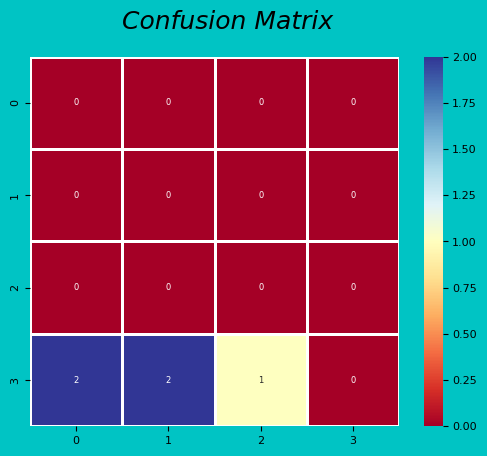

In [ ]:
# confusion matrix
from sklearn.metrics import confusion_matrix
# accuracy: (tp + tn) / (p + n)
from sklearn.metrics import accuracy_score
# classification_report
from sklearn.metrics import classification_report
# kappa
from sklearn.metrics import cohen_kappa_score


true_labels = out_df['act_label']
predicted_labels = out_df['pred_label']

matrix = confusion_matrix(true_labels, predicted_labels)
print(matrix, '\n')

accuracy = accuracy_score(true_labels, predicted_labels)
print('Accuracy: %f' % accuracy, '\n')
print('Error rate: %f' % (1-accuracy), '\n')

# Generate classification report
report = classification_report(true_labels, predicted_labels)
print(report, '\n')

kappa = cohen_kappa_score(true_labels, predicted_labels)
print('Cohens kappa: %f' % kappa)



# Commented out IPython magic to ensure Python compatibility.
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

plt.rcParams['font.size'] = 8
bg_color = (0, 0.77, 0.77)
plt.rcParams['figure.facecolor'] = bg_color
plt.rcParams['axes.facecolor'] = bg_color

fig, ax = plt.subplots(1)

plt.text(1, -.3, "Confusion Matrix", fontsize = 18, color='Black', fontstyle='italic')

ax = sns.heatmap(matrix, annot=True, annot_kws={'size':6}, fmt="d",
                 robust=True, linewidths=.9, cmap="RdYlBu", square=True)
# vmin=0, vmax=350,
plt.savefig("Confusion_Matrix.jpeg", dpi=300, facecolor=bg_color, transparent=True)
plt.show()

# Add BERT

In [ ]:
# import gensim.downloader as api

# model = api.load("fasttext-wiki-news-subwords-300")
# model.most_similar(positive=["bear", "animal"])


[('bears', 0.7806269526481628),
 ('bearlike', 0.7365133762359619),
 ('bear-human', 0.7334461808204651),
 ('wild-animal', 0.7238131761550903),
 ('bearing', 0.7206599116325378),
 ('bear-like', 0.7149178385734558),
 ('she-bear', 0.7096138596534729),
 ('man-animal', 0.7079933285713196),
 ('bearest', 0.7078123092651367),
 ('human-bear', 0.7067595720291138)]

# BERT Similarity

- most_similar() function

The most_similar function is a method available in many word embedding models, such as Word2Vec and FastText, provided by libraries like Gensim. This function allows you to find the words that are most similar to a given word based on the learned word embeddings.

However, BERT (Bidirectional Encoder Representations from Transformers) is a different type of model compared to Word2Vec and FastText. BERT is a transformer-based model primarily used for various natural language processing tasks, including text classification, question answering, and named entity recognition. Unlike Word2Vec and FastText, BERT does not directly output word embeddings that can be used with the most_similar function.

If you want to find similar words using BERT, you can use BERT embeddings to represent words or sentences and then compute similarity using cosine similarity or another metric. Here's a general approach to using BERT embeddings for similarity:

1. Fine-tune BERT: Fine-tune a pre-trained BERT model on your specific dataset if you have a labeled dataset and a specific downstream task.

2. Extract embeddings: Use the fine-tuned BERT model to extract word or sentence embeddings for your vocabulary or input sentences.

3. Compute similarity: Use a similarity metric such as cosine similarity to compute similarity between embeddings and find the most similar words or sentences.

A basic example of how you might use BERT embeddings and cosine similarity to find similar words:

In [ ]:
from transformers import BertModel, BertTokenizer
import torch
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
# Load pre-trained BERT model and tokenizer
model_name = 'bert-base-uncased'
tokenizer = BertTokenizer.from_pretrained(model_name)
model = BertModel.from_pretrained(model_name)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [ ]:
# Tokenize input word
input_word = "gorilla" # "cat"
input_ids = tokenizer.encode(input_word, return_tensors='pt')

In [ ]:
print(f"input_ids : {input_ids}")

input_ids : tensor([[  101, 23526,   102]])


In [ ]:
# Get BERT embeddings for input word
with torch.no_grad():
    outputs = model(input_ids)
    word_embedding = outputs.last_hidden_state.mean(dim=1).squeeze(0).numpy()
    print(f"outputs : {outputs} \nword_embedding : {word_embedding}")

outputs : BaseModelOutputWithPoolingAndCrossAttentions(last_hidden_state=tensor([[[-0.6432,  0.1909, -0.3537,  ..., -0.1675,  0.1406,  0.2187],
         [-0.3494, -0.4527, -0.9001,  ...,  0.2686,  0.2700, -0.2705],
         [ 0.9552,  0.0822, -0.1260,  ...,  0.1527, -0.7308, -0.2322]]]), pooler_output=tensor([[-0.8871, -0.3270, -0.2293,  0.8442, -0.0017, -0.2443,  0.9552,  0.2882,
         -0.4233, -0.9999, -0.3836,  0.7554,  0.9644,  0.1933,  0.9390, -0.7821,
         -0.5944, -0.5931,  0.4486, -0.8876,  0.6156,  0.9961,  0.3380,  0.3336,
          0.3997,  0.8776, -0.7853,  0.9100,  0.9510,  0.7203, -0.8301,  0.2124,
         -0.9755, -0.2893, -0.3278, -0.9753,  0.3657, -0.7478, -0.0752, -0.0228,
         -0.8775,  0.3235,  0.9990,  0.2431,  0.0019, -0.3708, -1.0000,  0.3177,
         -0.8353,  0.4454,  0.5319, -0.1095,  0.2574,  0.5195,  0.4968,  0.1434,
         -0.0499,  0.2192, -0.1963, -0.5458, -0.5644,  0.3523, -0.5384, -0.8421,
          0.5675,  0.0471, -0.2512, -0.3556, -0.1

In [ ]:
# Example vocabulary
vocabulary = ['cat', 'dog', 'blue_whale', 'chimpanzee', 'chimp', 'monkey',
              'bobcat', 'cow', 'dolphin', 'gorilla', 'killer_whale',
              'lion', 'mouse', 'ox', 'polar_bear', 'rabbit', 'rhinoceros',
              'siamese_cat', 'skunk', 'spider_monkey', 'squirrel',
              'tiger', 'walrus', 'giant_panda', 'giant', 'panda', 'bear',
              'seal', 'sealskin', 'walrus', 'rat']


In [ ]:
# Compute cosine similarity with input word
similarities = {}
for word in vocabulary:
    # Tokenize and get embeddings for each word in the vocabulary
    word_ids = tokenizer.encode(word, return_tensors='pt')
    with torch.no_grad():
        outputs = model(word_ids)
        word_embedding_other = outputs.last_hidden_state.mean(dim=1).squeeze(0).numpy()

    # Compute cosine similarity
    similarity = cosine_similarity([word_embedding], [word_embedding_other])[0][0]
    similarities[word] = similarity

print(f"similarities : {similarities} \n")

# Sort words by similarity
similar_words = sorted(similarities, key=similarities.get, reverse=True)

# Print top similar words
print("Top similar words to '{}':".format(input_word))
for word in similar_words[:10]:
    print(word)

similarities : {'cat': 0.8453042, 'dog': 0.8451747, 'blue_whale': 0.5988388, 'chimpanzee': 0.49142528, 'chimp': 0.79280424, 'monkey': 0.90579844, 'bobcat': 0.60527635, 'cow': 0.87875307, 'dolphin': 0.8224089, 'gorilla': 1.0, 'killer_whale': 0.58878565, 'lion': 0.8942107, 'mouse': 0.9087419, 'ox': 0.8222094, 'polar_bear': 0.6690042, 'rabbit': 0.90121424, 'rhinoceros': 0.5969634, 'siamese_cat': 0.6174811, 'skunk': 0.65024185, 'spider_monkey': 0.6432841, 'squirrel': 0.8976769, 'tiger': 0.9107058, 'walrus': 0.7300297, 'giant_panda': 0.7093071, 'giant': 0.8627902, 'panda': 0.9068123, 'bear': 0.9068084, 'seal': 0.8361885, 'sealskin': 0.76396966, 'rat': 0.8723434} 

Top similar words to 'gorilla':
gorilla
tiger
mouse
panda
bear
monkey
rabbit
squirrel
lion
cow


# Predict with BERT

In [ ]:
def predict_with_bert(input_word, vocabulary, top_n=5):

    # Load pre-trained BERT model and tokenizer
    model_name = 'bert-base-uncased'
    tokenizer = BertTokenizer.from_pretrained(model_name)
    model = BertModel.from_pretrained(model_name)

    # Tokenize input word
    input_ids = tokenizer.encode(input_word, return_tensors='pt')

    # Get BERT embeddings for input word
    with torch.no_grad():
        outputs = model(input_ids)
        word_embedding = outputs.last_hidden_state.mean(dim=1).squeeze(0).numpy()

    # Compute cosine similarity with input word
    similarities = {}
    for word in vocabulary:
        # Tokenize and get embeddings for each word in the vocabulary
        word_ids = tokenizer.encode(word, return_tensors='pt')
        with torch.no_grad():
            outputs = model(word_ids)
            word_embedding_other = outputs.last_hidden_state.mean(dim=1).squeeze(0).numpy()

        # Compute cosine similarity
        similarity = cosine_similarity([word_embedding], [word_embedding_other])[0][0]
        similarities[word] = similarity

#     print(f"similarities : {similarities} \n")

    # Sort words by similarity
    similar_words = sorted(similarities, key=similarities.get, reverse=True)

    # Print top similar words
#     print("Top similar words to '{}':".format(input_word))
#     for word in similar_words[:10]:
#         print(word)

    return similar_words[:top_n]


In [ ]:
# Load models
classification_model = load_model('model_h5_sample100.h5')
min_max_scaler_model = load(open('min_max_scaler_h5_sample100.pkl', 'rb'))
class_labels = ['bear', 'blue_whale', 'bobcat', 'cow', 'dolphin', 'gorilla',
                 'killer_whale', 'lion', 'monkey', 'mouse', 'ox', 'rabbit',
                 'rhinoceros', 'siamese_cat', 'skunk', 'squirrel', 'tiger', 'walrus','chimpanzee', 'giant_panda', 'hippopotamus', 'humpback_whale', 'leopard',
                'persian_cat', 'pig', 'raccoon', 'rat', 'seal']
class_labels_test = ['chimp', 'chimpanzee', 'giant_panda', 'hippopotamus', 'humpback_whale', 'leopard',
                'persian_cat', 'pig', 'raccoon', 'rat', 'seal']


image_path, image_label, pred_image_label, act_label, pred_label = [], [], [], [], []

for img_path in glob.glob(r"/content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/*/*"):
    print(f"img_path : {img_path}")
    image_path.append(img_path)
    image_label.append(img_path.split('/')[-2])
    act_label.append(class_labels.index(img_path.split('/')[-2]))

    # Extract visual features using ResNet50
    visual_features = extract_visual_features(img_path)
#     print(f"visual_features : {visual_features.shape} || {type(visual_features)}")

    # Compute texture features using GLCM
    texture_features = compute_texture_features(img_path)
#     print(f"texture_feat : {texture_features.shape} || {type(texture_features)}")

    # Concatenate visual and texture features
    l1 = visual_features[0].tolist()
    l2 = texture_features.tolist()
    l1.extend(l2)
    combined_features = np.array(l1)
#     print(f"combined_features : {combined_features}")

    # Normalize the features
    train_normalized_texture_features = min_max_scaler_model.transform([combined_features])
    train_normalized_texture_features_df = pd.DataFrame(train_normalized_texture_features)
#     print(f"train_normalized_texture_features_df : {train_normalized_texture_features_df}")

#     model.predict
    predicted_value = classification_model.predict(train_normalized_texture_features_df)
    print(f"predicted_value : {np.argmax(predicted_value)} || {class_labels[np.argmax(predicted_value)]}")
    pred_image_label.append(class_labels[np.argmax(predicted_value)])
    pred_label.append(np.argmax(predicted_value))

    similar_words_bert = predict_with_bert(class_labels[np.argmax(predicted_value)], class_labels_test)
    print(f"similar_words_bert : {similar_words_bert}")

    #break

img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/chimpanzee/chimpanzee_10003.jpg
1/1 [==============================] - 3s 3s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 175ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/chimpanzee/chimpanzee_10004.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 22ms/step
predicted_value : 5 || gorilla
similar_words_bert : ['leopard', 'pig', 'rat', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/chimpanzee/chimpanzee_10001.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 23ms/step
predicted_value : 8 || monkey
similar_words_bert : ['pig', 'rat', 'seal', 'leopard', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/chimpanzee/chimpanzee_10005.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 24ms/step
predicted_value : 8 || monkey
similar_words_bert : ['pig', 'rat', 'seal', 'leopard', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/chimpanzee/chimpanzee_10002.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 26ms/step
predicted_value : 5 || gorilla
similar_words_bert : ['leopard', 'pig', 'rat', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/leopard/leopard_10001.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 40ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 16 || tiger
similar_words_bert : ['leopard', 'pig', 'rat', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/leopard/leopard_10004.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 24ms/step
predicted_value : 2 || bobcat
similar_words_bert : ['raccoon', 'chimp', 'chimpanzee', 'leopard', 'humpback_whale']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/leopard/leopard_10002.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 39ms/step
predicted_value : 2 || bobcat
similar_words_bert : ['raccoon', 'chimp', 'chimpanzee', 'leopard', 'humpback_whale']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/leopard/leopard_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 23ms/step
predicted_value : 2 || bobcat
similar_words_bert : ['raccoon', 'chimp', 'chimpanzee', 'leopard', 'humpback_whale']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/leopard/leopard_10003.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 28ms/step
predicted_value : 2 || bobcat
similar_words_bert : ['raccoon', 'chimp', 'chimpanzee', 'leopard', 'humpback_whale']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/humpback_whale/humpback+whale_10001.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 36ms/step
predicted_value : 1 || blue_whale
similar_words_bert : ['giant_panda', 'humpback_whale', 'persian_cat', 'chimp', 'seal']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/humpback_whale/humpback+whale_10004.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 37ms/step
predicted_value : 1 || blue_whale
similar_words_bert : ['giant_panda', 'humpback_whale', 'persian_cat', 'chimp', 'seal']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/humpback_whale/humpback+whale_10005.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 34ms/step
predicted_value : 1 || blue_whale
similar_words_bert : ['giant_panda', 'humpback_whale', 'persian_cat', 'chimp', 'seal']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/humpback_whale/humpback+whale_10003.jpg
1/1 [==============================] - ETA: 0s

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 21ms/step
predicted_value : 1 || blue_whale
similar_words_bert : ['giant_panda', 'humpback_whale', 'persian_cat', 'chimp', 'seal']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/humpback_whale/humpback+whale_10002.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 33ms/step
predicted_value : 1 || blue_whale
similar_words_bert : ['giant_panda', 'humpback_whale', 'persian_cat', 'chimp', 'seal']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/giant_panda/giant+panda_10002.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 24ms/step
predicted_value : 14 || skunk
similar_words_bert : ['chimp', 'rat', 'seal', 'raccoon', 'giant_panda']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/giant_panda/giant+panda_10003.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')


predicted_value : 0 || bear
similar_words_bert : ['pig', 'leopard', 'rat', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/giant_panda/giant+panda_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 28ms/step
predicted_value : 14 || skunk
similar_words_bert : ['chimp', 'rat', 'seal', 'raccoon', 'giant_panda']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/giant_panda/giant+panda_10004.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 40ms/step
predicted_value : 8 || monkey
similar_words_bert : ['pig', 'rat', 'seal', 'leopard', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/giant_panda/giant+panda_10001.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 28ms/step
predicted_value : 0 || bear
similar_words_bert : ['pig', 'leopard', 'rat', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/persian_cat/persian+cat_10004.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 31ms/step
predicted_value : 13 || siamese_cat
similar_words_bert : ['persian_cat', 'giant_panda', 'chimp', 'pig', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/persian_cat/persian+cat_10002.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 30ms/step
predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/persian_cat/persian+cat_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 31ms/step
predicted_value : 13 || siamese_cat
similar_words_bert : ['persian_cat', 'giant_panda', 'chimp', 'pig', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/persian_cat/persian+cat_10001.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 25ms/step
predicted_value : 13 || siamese_cat
similar_words_bert : ['persian_cat', 'giant_panda', 'chimp', 'pig', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/persian_cat/persian+cat_10003.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 29ms/step
predicted_value : 13 || siamese_cat
similar_words_bert : ['persian_cat', 'giant_panda', 'chimp', 'pig', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/hippopotamus/hippopotamus_10001.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 23ms/step
predicted_value : 8 || monkey
similar_words_bert : ['pig', 'rat', 'seal', 'leopard', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/hippopotamus/hippopotamus_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 25ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/hippopotamus/hippopotamus_10003.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 29ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/hippopotamus/hippopotamus_10002.jpg
1/1 [==============================] - 0s 21ms/step
predicted_value : 17 || walrus


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/hippopotamus/hippopotamus_10004.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 12 || rhinoceros
similar_words_bert : ['raccoon', 'chimpanzee', 'hippopotamus', 'chimp', 'leopard']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/raccoon/raccoon_10004.jpg
1/1 [==============================] - 0s 22ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/raccoon/raccoon_10005.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 22ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/raccoon/raccoon_10001.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 25ms/step
predicted_value : 8 || monkey
similar_words_bert : ['pig', 'rat', 'seal', 'leopard', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/raccoon/raccoon_10002.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 39ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 14 || skunk
similar_words_bert : ['chimp', 'rat', 'seal', 'raccoon', 'giant_panda']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/raccoon/raccoon_10003.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 21ms/step
predicted_value : 14 || skunk
similar_words_bert : ['chimp', 'rat', 'seal', 'raccoon', 'giant_panda']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/pig/pig_10004.jpg
1/1 [==============================] - 0s 21ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/pig/pig_10002.jpg
1/1 [==============================] - 0s 23ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/pig/pig_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 22ms/step
predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/pig/pig_10001.jpg
1/1 [==============================] - 0s 21ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/pig/pig_10003.jpg
1/1 [==============================] - 0s 22ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 11 || rabbit
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/seal/seal_10003.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 31ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/seal/seal_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 22ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/seal/seal_10001.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 23ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/seal/seal_10002.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 21ms/step
predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/seal/seal_10004.jpg
1/1 [==============================] - 0s 21ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 17 || walrus
similar_words_bert : ['chimp', 'raccoon', 'leopard', 'giant_panda', 'rat']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/rat/rat_10005.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 20ms/step
predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/rat/rat_10003.jpg
1/1 [==============================] - 2s 2s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 22ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')


predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/rat/rat_10002.jpg
1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 27ms/step
predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/rat/rat_10004.jpg
1/1 [==============================] - 3s 3s/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

1/1 [==============================] - 0s 38ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']
img_path : /content/drive/MyDrive/phd_w0rk_2023/bert/Test_samples/rat/rat_10001.jpg
1/1 [==============================] - 0s 24ms/step


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

predicted_value : 9 || mouse
similar_words_bert : ['pig', 'rat', 'leopard', 'seal', 'chimp']


# Working on...

# get verbos

In [ ]:
!pip install requests
!pip install wikipedia-api


[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
import wikipediaapi

headers = {"User-Agent": "Mozilla/5.0 (X11; Linux x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/51.0.2704.103 Safari/537.36"}
wiki = wikipediaapi.Wikipedia('en', headers=headers)

for animal in vocabulary:
    page = wiki.page(animal)
    print(animal, ' : ')
#     print(wiki.extracts(page, exsentences=1))
    print(wiki.extracts(page, exsentences=10), '\n\n')

cat  : 
The cat (Felis catus), commonly referred to as the domestic cat or house cat, is the only domesticated species in the family Felidae. Recent advances in archaeology and genetics have shown that the domestication of the cat occurred in the Near East around 7500 BC. It is commonly kept as a house pet and farm cat, but also ranges freely as a feral cat avoiding human contact. It is valued by humans for companionship and its ability to kill vermin. Its retractable claws are adapted to killing small prey like mice and rats. It has a strong, flexible body, quick reflexes, sharp teeth, and its night vision and sense of smell are well developed. It is a social species, but a solitary hunter and a crepuscular predator. Cat communication includes vocalizations like meowing, purring, trilling, hissing, growling, and grunting as well as cat body language. It can hear sounds too faint or too high in frequency for human ears, such as those made by small mammals. It also secretes and perceive

Cattle (Bos taurus) are large, domesticated, bovid ungulates widely kept as livestock. They are prominent modern members of the subfamily Bovinae and the most widespread species of the genus Bos. Mature female cattle are called cows and mature male cattle are bulls. Young female cattle are called heifers, young male cattle are oxen or bullocks, and castrated male cattle are known as steers.
Cattle are commonly raised for meat, for dairy products, and for leather. As draft animals, they pull carts and farm implements. In  India, cattle are sacred animals within Hinduism, and may not be killed. Small breeds such as the miniature Zebu are kept as pets.
Taurine cattle are widely distributed across Europe and temperate areas of Asia, the Americas, and Australia. Zebus are found mainly in India and tropical areas of Asia, America, and Australia. 


dolphin  : 
A dolphin is an aquatic mammal within the infraorder Cetacea. Dolphin species belong to the families Delphinidae (the oceanic dolphin

A rhinoceros (; from Ancient Greek  ῥινόκερως (rhinókerōs) 'nose-horned'; from  ῥίς (rhis) 'nose', and  κέρας (kéras) 'horn'; pl.: rhinoceros or rhinoceroses), commonly abbreviated to rhino, is a member of any of the five extant species (or numerous extinct species) of odd-toed ungulates in the family Rhinocerotidae; it can also refer to a member of any of the extinct species of the superfamily Rhinocerotoidea. Two of the extant species are native to Africa, and three to South and Southeast Asia.
Rhinoceroses are some of the largest remaining megafauna: all weigh at least one tonne in adulthood. They have a herbivorous diet, small brains 400–600 g (14–21 oz) for mammals of their size, one or two horns, and a thick 1.5–5 cm (0.59–1.97 in), protective skin formed from layers of collagen positioned in a lattice structure. They generally eat leafy material, although their ability to ferment food in their hindgut allows them to subsist on more fibrous plant matter when necessary. Unlike oth

The giant panda (Ailuropoda melanoleuca), also known as the panda bear or simply panda, is a bear species endemic to China. It is characterised by its bold black-and-white coat and rotund body. The name "giant panda" is sometimes used to distinguish it from the red panda, a neighboring musteloid. Adult individuals average 100 to 115 kg (220 to 254 lb), and are typically 1.2 to 1.9 m (3 ft 11 in to 6 ft 3 in) long. The species is sexually dimorphic, as males are typically 10 to 20% larger. The fur is white, with black patches around the eyes, ears, legs and shoulders. A thumb is visible on the bear's forepaw, which helps in holding bamboo in place for feeding. Giant pandas have adapted larger molars and expanded temporal fossa to meet their dietary requirements. 
Giant pandas are only found in six mountains in a few provinces. They are also found in elevations of up to 3,000 m (9,800 ft). 


giant  : 
In folklore, giants (from Ancient Greek: gigas, cognate giga-) are beings of humanoid 